# SCS 3546 Deep Learning Week 4 

# Deep Computer Vision

## Learning Outcome

In this module, we move beyond using CNN for Image Classification and introduce more advanced networks to address some important Computer Vision tasks. This topic deserves one complete course by itself, but we will only dive into two of the comon tasks: Object Detection and Instance Segmentation. The concepts introduced in this module will help you to read and understand other networks designed for computer vision tasks. 



## Topics
- [Introduction to Computer Vision](#s1)
- [Transfer Learning and Visual Feature Extraction](#s2)
    - [Visual Feature Extraction](#s2.1)
    - [When and How to Fine-tune](#s2.2)
    - [Practical Notes](#s2.3)
    - [Transfer Learning & Fine-tuning in Keras/Tensorflow](#s2.4)
- [Classification + Localization](#s3)
    - [Training & Evaluation](#s3.1)
- [Object Detection](#s4)
    - [Sliding Window Approach](#s4.1)
    - [Region Proposals](#s4.2)
    - [R-CNN](#s4.3)
    - [Fast R-CNN](#s4.4)
    - [Faster R-CNN](#s4.5)
    - [Mask R-CNN (Object Detection + Instance Segmentation)](#s4.6)
    - [Demo: Mask R-CNN](#s4.7)
    - [Single Shot Detectors](#s4.8)
    - [YOLO](#s4.9)
    - [SSD](#s4.10)
    - [Speed / Accuracy Comparison of Object Detectors](#s4.11)
    - [Impact of Deep Learning on Object Detection](#s4.12)
    - [Demo: Tensorflow Object Detection API](#s4.13)
- [Semantic Segmentation](#s5)
    - [Sliding Window Approach](#s5.1)
    - [Fully Convolutional Networks (FCN) for Semantic Segmentation](#s5.2)
    - [U-Net](#s5.3)
    - [Real-time Semantic Segmentation](#s5.4)
- [Next Week](#s6)
- [References](#s7)


<a id="s1"></a>
## Introduction to Computer Vision

__Computer vision__ is an interdisciplinary field that deals with how computers can be made to gain high-level understanding from digital images or videos. 

__From the perspective of engineering__, it seeks to automate tasks that the human visual system can do. __Computer vision__ is concerned with the automatic extraction, analysis and understanding of useful information from a single image or a sequence of images. It involves the development of a theoretical and algorithmic basis to achieve automatic visual understanding.

__As a scientific discipline__, computer vision is concerned with the theory behind artificial systems that extract information from images. The image data can take many forms, such as video sequences, views from multiple cameras, or multi-dimensional data from a medical scanner.

__As a technological discipline__, computer vision seeks to apply its theories and models for the construction of computer vision systems.

Some of the common tasks in computer vision are as follows:

- Image Classification
- Classification + Localization
- Object Detection
- Instant Segmentation
- Semantic Segmentation
- Face Detection
- Image Captioning
- Action Detection in Videos
- Object Tracking in Videos
- and many more

Computer vision scientists have worked on the above tasks for decades and lots of mothods have been develped. However, the recent advnces in deep neural networks has brought much more success to this descipline than ever. Traditionally, scientists were relying on extracting manual features from images or videos to understand them or to extract useful information. But nowdays the features exctracted using Convolutional Neural Networks have revouloutionized this field. 

__Image Classification__ using different __CNN__ architectures was discussed in details in the previous module. In this module, we will move beyond classification and introduce the new methods and algorithms for two other common computer vision tasks using deep neural networks (DNNs). We will focus on object detection and image segmentation to introduce some common deep learning techniques used in computer vision.      

Before diving into details of each task, we will need to discuss the concept of Transfer Learning and Visual Feature Extraction using DNNs  

<a id="s2"></a>
## Transfer Learning & Visual Feature Extraction

In the previous module we introduced __CNN__s and how they were used for classification of images in ImageNet dataset. We observed that training these complex nural networks required large number of images (e.g. ImageNet contains 1.2 million images with 1000 categories). However, in practice (e.g. clssifying images not coming from ImageNet), almost nobody has access to that many images to train complex classifiers from scratch. Instead, it is common to pretrain a ConvNet (CNN) on a very large dataset (e.g. ImageNet), and then use the ConvNet either as an initialization or a fixed feature extractor for the task of interest (e.g. classification). This method is called __Transfer Learning__. 

There are hree major Transfer Learning scenarios as follows:

- __ConvNet as a fixed feature extractor__: In this strategy, we take a ConvNet pretrained on ImageNet, remove the last fully-connected layer (this layer’s outputs are the 1000 class scores for a different task like ImageNet), then treat the rest of the ConvNet as a fixed feature extractor for the new dataset. In an AlexNet, this would compute a 4096-D vector for every image that contains the activations of the hidden layer immediately before the classifier. We call these features __CNN codes__. It is important for performance that these codes are ReLUd (i.e. thresholded at zero) if they were also thresholded during the training of the ConvNet on ImageNet (as is usually the case). Once we extract the 4096-D codes for all images, we can train a linear classifier (e.g. Linear SVM or Softmax classifier) for the new dataset.

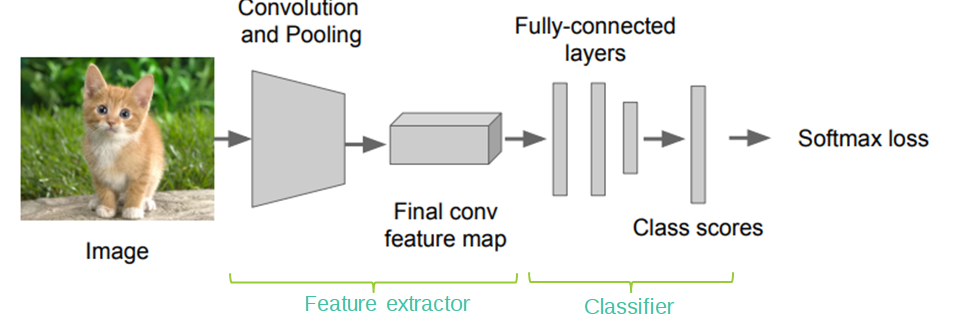

<br><bbr>

<center>Source: https://www.quora.com/How-can-I-use-CNN-for-feature-extraction-of-images</center>

- __Fine-tuning the ConvNet__: The second strategy is to not only replace and retrain the classifier on top of the ConvNet on the new dataset, but to also fine-tune the weights of the pretrained network by continuing the backpropagation. It is possible to fine-tune all the layers of the ConvNet, or it’s possible to keep some of the earlier layers fixed (due to overfitting concerns) and only fine-tune some higher-level portion of the network. This is motivated by the observation that the earlier features of a ConvNet contain more generic features (e.g. edge detectors or color blob detectors) that should be useful to many tasks, but later layers of the ConvNet becomes progressively more specific to the details of the classes contained in the original dataset. In case of ImageNet for example, which contains many dog breeds, a significant portion of the representational power of the ConvNet may be devoted to features that are specific to differentiating between dog breeds.

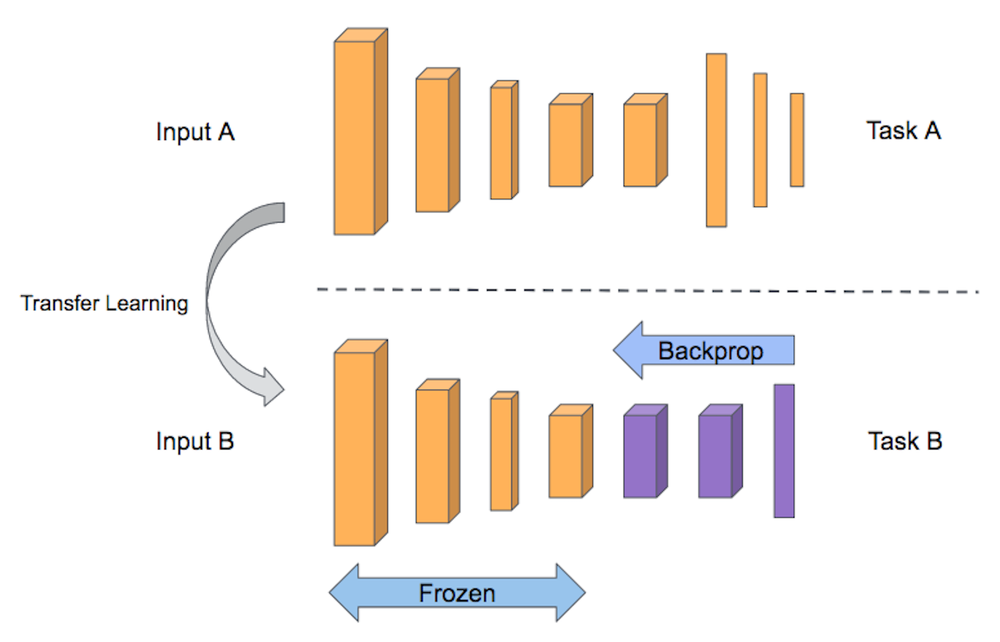
<br><br><center>Source: https://medium.com/@subodh.malgonde/transfer-learning-using-tensorflow-52a4f6bcde3e</center>

- __Pretrained models__: Since modern ConvNets take 2-3 weeks to train across multiple GPUs on ImageNet, it is common to see people release their final ConvNet checkpoints for the benefit of others who can use the networks for fine-tuning. For example, many deep learning libraries have Model Zoos where people share their network weights. You can find a collection of TensorFlow models in the <a href="https://github.com/tensorflow/models" target="_blank">TensorFlow Zoo</a>.

<a id=s2.1></a>
### Visual Feature Extraction

Although, we exaplined different methods of transfer learning for image classification but it can also be used for other computer vision tasks. In fact, most of the models we will explore in this module use one or more ConvNet as their base and they use one of the transfer learning methods. We can also use the same startegies as explained above to use the same models for our own datasets.   

<a id=s2.2></a>
### When and How to Fine-tune

How to decide what type of transfer learning we should perform on a new dataset? 

This is a function of several factors, but the two most important ones are the size of the new dataset (small or big), and its similarity to the original dataset (e.g. ImageNet-like in terms of the content of images and the classes, or very different, such as microscope images). Keeping in mind that ConvNet features are more generic in early layers and more original-dataset-specific in later layers, here are some common rules of thumb for navigating the 4 major scenarios:

- __New dataset is small and similar to original dataset__: Since the data is small, it is not a good idea to fine-tune the ConvNet due to overfitting concerns. Since the data is similar to the original data, we expect higher-level features in the ConvNet to be relevant to this dataset as well. Hence, the best idea might be to train a linear classifier on the CNN codes.


- __New dataset is large and similar to the original dataset__: Since we have more data, we can have more confidence that we won’t overfit if we were to try to fine-tune through the full network.


- __New dataset is small but very different from the original dataset__: Since the data is small, it is likely best to only train a linear classifier. Since the dataset is very different, it might not be best to train the classifier form the top of the network, which contains more dataset-specific features. Instead, it might work better to train the SVM classifier from activations somewhere earlier in the network.


- __New dataset is large and very different from the original dataset__: Since the dataset is very large, we may expect that we can afford to train a ConvNet from scratch. However, in practice it is very often still beneficial to initialize with weights from a pretrained model. In this case, we would have enough data and confidence to fine-tune through the entire network.

For more details, you can refer to this paper https://arxiv.org/abs/1411.1792. 

<a id=s2.3></a>
### Practical Notes

- __Constraints from pretrained models__: Note that if you wish to use a pretrained network, you may be slightly constrained in terms of the architecture you can use for your new dataset. For example, you can’t arbitrarily take out Conv layers from the pretrained network. However, some changes are straight-forward: Due to parameter sharing, you can easily run a pretrained network on images of different spatial size. This is clearly evident in the case of Conv/Pool layers because their forward function is independent of the input volume spatial size (as long as the strides “fit”). In case of FC layers, this still holds true because FC layers can be converted to a Convolutional Layer: For example, in an AlexNet, the final pooling volume before the first FC layer is of size [6x6x512]. Therefore, the FC layer looking at this volume is equivalent to having a Convolutional Layer that has receptive field size 6x6, and is applied with padding of 0.


- __Learning rates__: It’s common to use a smaller learning rate for ConvNet weights that are being fine-tuned, in comparison to the (randomly-initialized) weights for the new linear classifier that computes the class scores of your new dataset. This is because we expect that the ConvNet weights are relatively good, so we don’t wish to distort them too quickly and too much (especially while the new Linear Classifier above them is being trained from random initialization).

<a id=s2.4></a>
### Transfer Learning & Fine-tuning in Keras/Tensorflow

 #### Using Pre-trained Models


In [3]:
from keras import applications

# VGG16 Model with defalut parameters
model = applications.VGG16()
model.summary()

Using TensorFlow backend.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

In [4]:
# VGG16 pre-trained model without fully connected layers and with different input dimensions
image_w, image_h = 300, 300
model = applications.VGG16(weights = "imagenet", include_top=False, input_shape = (image_w, image_h, 3))
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 300, 300, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 300, 300, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 300, 300, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 150, 150, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 150, 150, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 150, 150, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 75, 75, 128)       0         
__________

In [5]:
# Trainable layers
for i, layer in enumerate(model.layers):
    print(i, layer.name, layer.trainable)


0 input_2 False
1 block1_conv1 True
2 block1_conv2 True
3 block1_pool True
4 block2_conv1 True
5 block2_conv2 True
6 block2_pool True
7 block3_conv1 True
8 block3_conv2 True
9 block3_conv3 True
10 block3_pool True
11 block4_conv1 True
12 block4_conv2 True
13 block4_conv3 True
14 block4_pool True
15 block5_conv1 True
16 block5_conv2 True
17 block5_conv3 True
18 block5_pool True


In [6]:
# Freezing the layers we don't want to train (here I freeze  until the end of block 2 = 7 layers)
for layer in model.layers[:7]:
    layer.trainable = False

In [7]:
for i, layer in enumerate(model.layers):
    print(i, layer.name, layer.trainable)

0 input_2 False
1 block1_conv1 False
2 block1_conv2 False
3 block1_pool False
4 block2_conv1 False
5 block2_conv2 False
6 block2_pool False
7 block3_conv1 True
8 block3_conv2 True
9 block3_conv3 True
10 block3_pool True
11 block4_conv1 True
12 block4_conv2 True
13 block4_conv3 True
14 block4_pool True
15 block5_conv1 True
16 block5_conv2 True
17 block5_conv3 True
18 block5_pool True


In [8]:
# Adding custom layers to create a new model 
from keras.models import Sequential, Model
from keras.layers import Dropout, Flatten, Dense, GlobalAveragePooling2D
from keras import optimizers

new_model = Sequential([
    model,
    Flatten(name='flatten'),
    Dense(1024, activation='relu', name='new_fc1'),
    Dropout(0.5),
    Dense(1024, activation='relu', name='new_fc2'),
    Dense(10, activation='softmax', name='new_predictions')
])
new_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 9, 9, 512)         14714688  
_________________________________________________________________
flatten (Flatten)            (None, 41472)             0         
_________________________________________________________________
new_fc1 (Dense)              (None, 1024)              42468352  
_________________________________________________________________
dropout_1 (Dropout)          (None, 1024)              0         
_________________________________________________________________
new_fc2 (Dense)              (None, 1024)              1049600   
_________________________________________________________________
new_predictions (Dense)      (None, 10)                10250     
Total params: 58,242,890
Trainable params: 57,982,730
Non-trainable params: 260,160
__________________________________________________________

In [9]:
# Compiling the model
new_model.compile(loss = "categorical_crossentropy", optimizer = optimizers.SGD(lr=0.0001, momentum=0.9), metrics=["accuracy"])

<a id="s3"></a>
## Classification + Localization

The next natural step after image classification is to locate the object in the picture. The following image shows teh difference between __Image Classification__ and and __Classification + Localization__. As shown in the image, in the latter, we locate the object by estimating teh coordinates of a rectangular bounding box around the object.   

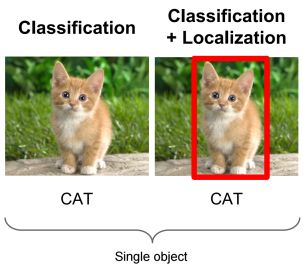
<br><center>L.A. Santos, GitBooks: Artificila Intelligence</center>

Estimating the coordinates of the bounding box can be considered as a __Regression__ task with four outputs (x, y, w, h). The following image shows a candidate architecture to do both classification and regression tasks in parallel. The convolutional layers are shared and their output (feature map) is fed to two fully connected heads for classification and regression tasks. 

<img src="classification_localization_architecture.png" width="100%">
<br><center>Source: L.A. Santos, GitBooks: Artificila Intelligence</center>

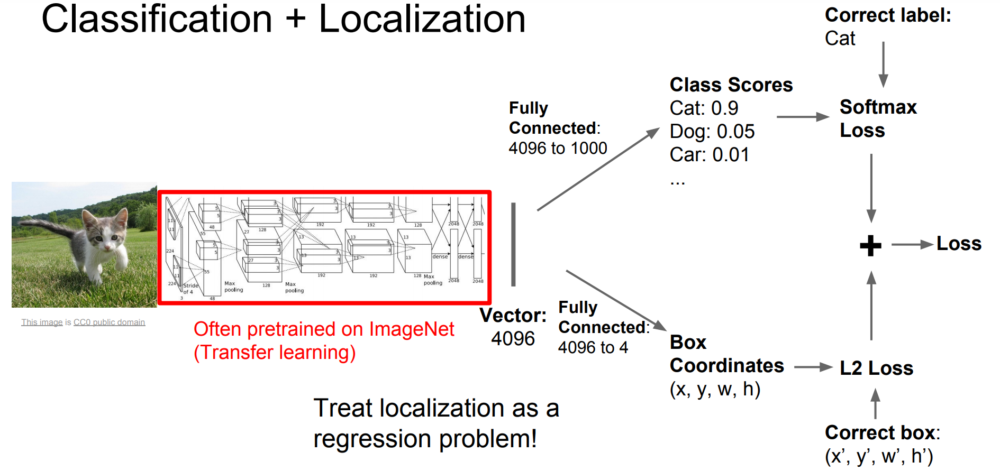
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

To evaluate the performance of the model, we need to masure the performance of both classifier and the regressor. Classification performance is measured the standard way that we have already discussed. But to measure the accuracy of the predicted bounding boxes, we need to introduce the concept of __Intersection of Union (IoU)__. The following images show how IOU is calculated and what different levels of IOU mean. The total accuracy will be defined as the means of all IoUs for all test images. 

<a id="s3.1"></a>
### Training & Evaluation

To traoin the suggested model, we usually pre-load the weighst of teh convoloutional layres from ImageNet models (transfer learning). If we don't have a lot of labeled images of if the images are similar to imageNet, then we can freeze those weights. For parallel training of both classification and regression, we would need a loss function that includes both classification loss and regression loss (shown in the diagram below):

$$ Total \space Loss = Classification \space (Softmax) \space Loss \space + \space Regression \space (L2) \space Loss $$


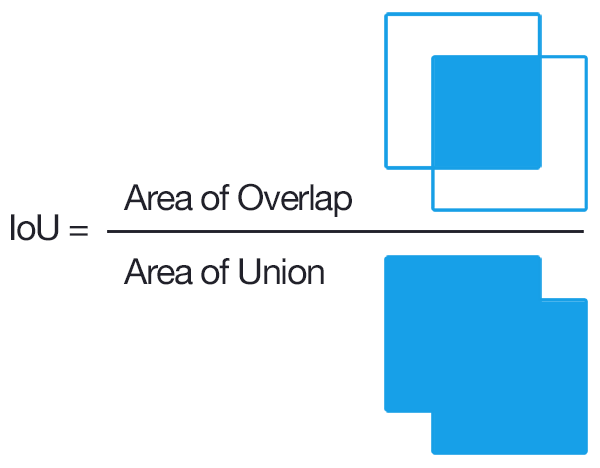
<br><center>A. Rosebrock, Intersection over Union (IoU) for object detection, 2016</center>

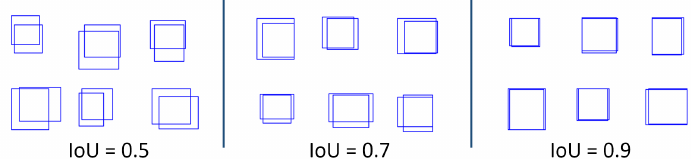
<br><center>Source: L.A. Santos, GitBooks: Artificila Intelligence</center>

<a id="s4"></a>
## Object Detection

Clssification + Localization is a relatively simple task because we are assuming there is only one main object in the image and the model predicts the class and the coordinates of the bounding box around that object alone. But in the most of the applications, there are more objects in an image and we want to detect all the objects inluding their type (class) and their bounding boxes (images below). This is a much more challenging task comparing to localization of a single object. 

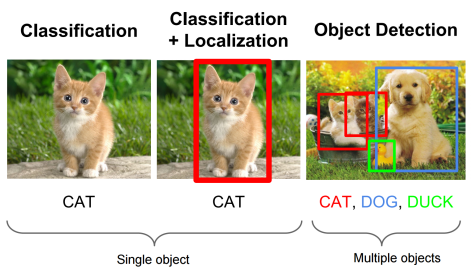
<br><center>Source: L.A. Santos, GitBooks: Artificila Intelligence</center>

<a id="s4.1"></a>
### Sliding Window Approach

One naive method is to apply a CNN to many different crops of the image, with different sizes and different aspect ratios. CNN classifies each crop as one of the known objects or background. The following images shows how the concept of sliding window works.

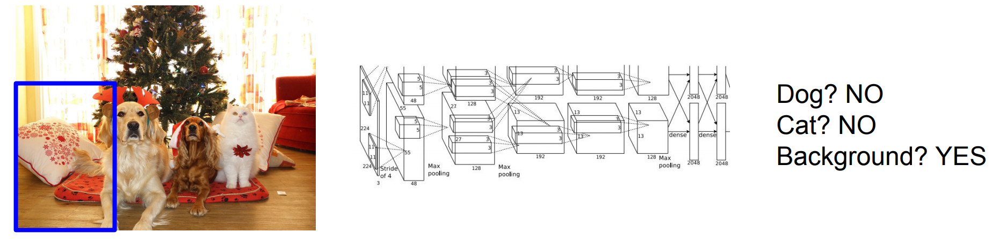
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

But the problem is that we need to apply CNN to huge number of locations, scales, and aspect ratios, that is very computationally expensive!

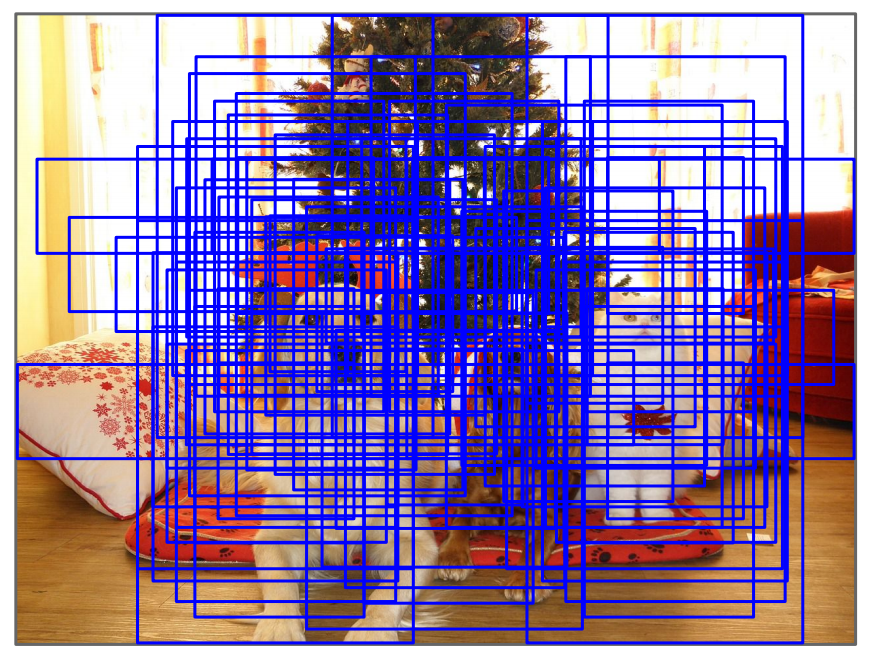
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

<a id="s4.2"></a>
### Region Proposals

One way to solvde the above problem is to find a way to estimate the image regions that are likely to contain objects (a.k.a. __Region Proposals__). An important property of a region proposal method is to have a very high recall. This means that the regions that contain the objects we are looking have to be in our list of region proposals (very low false negative).

Several region proposal methods have been proposed but __Selective Search__ is most commonly used because it is fast and has a very high recall. It is designed to be fast (gives 2000 region proposals in a few seconds on CPU) with a very high recall. It is based on computing hierarchical grouping of similar regions based on color, texture, size and shape compatibility.

We will not discuss the details of this algorithm because the recent state-of-the-arts models are not using search methods anymore. For more information, you can read <a href="https://www.learnopencv.com/selective-search-for-object-detection-cpp-python/" target="_blank">this blog</a>.

<a id="s4.3"></a>
### R-CNN

R-CNN, that stands for Regions and CNN Features, is a model that was suggested by <a href="https://arxiv.org/abs/1311.2524" target="_blank">Girshick et al</a>. 

Object detection in R-CNN is done in the following steps:

1. Take a pre-trained ImageNet CNN (e.g. AlexNet)

2. Re-train the last fully connected layer with the objects that need to be detected + "no-object" class

3. Find the __Regions of Interests (ROI)__ using Selective Search (Region Proposals) and save them on a disk

4. Train a SVM to classify between object and background (One binary SVM for each class)

5. Train a linear regression model (Bounding-Box Regressor) that will output bounding box offsets (comparing to the proposed region)

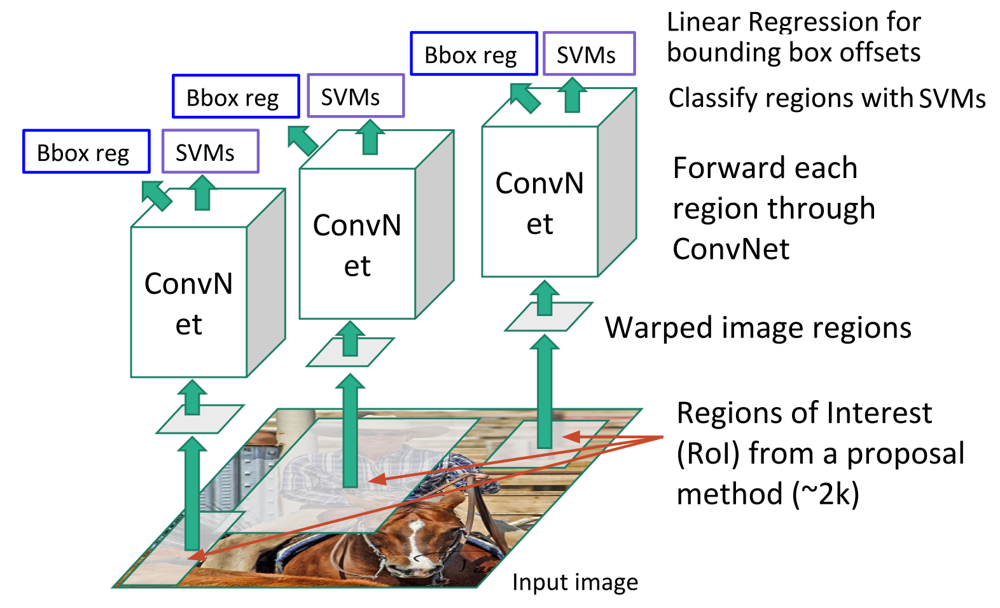
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

R-CNN is a good step forward toward more efficient object detection but it has the following problems:

1. It is has a ad-hoc training process:
    1. Fine-tune network with softmax classifier (log loss)
    1.Train post-hoc linear SVMs (hinge loss)
    1. Train post-hoc bounding-box regressions (least squares)
1. Training is very slow (long hours > 80H) and takes a lot of disk space
1. Inference (detection) is slow too because of two main reasons:
    1. Seraching region proposals takes a coupls of seconds 
    1. Running all 2000 regions through the entire CNN will take tens of seconds. 

Because the inference is slow this method is not appropriate for real-time (video) applications. 

<a id="s4.4"></a>
### Fast R-CNN

One major issue with R-CNN was the speed due to the fact that around 2000image crops had to go through an entire CNN. The creators of R-CNN suggested another model to solve this problem. The idea of <a href="https://arxiv.org/abs/1504.08083" target="_blank">Fast R-CNN</a> is that instead of applying all ROIs to a CNN, we apply the whole image to the CNN once and then find the ROIs on the feature map of the image. Fast R-CNN still uses Selective search method to find ROIs but it does it on the output of the CNN. 

<br>
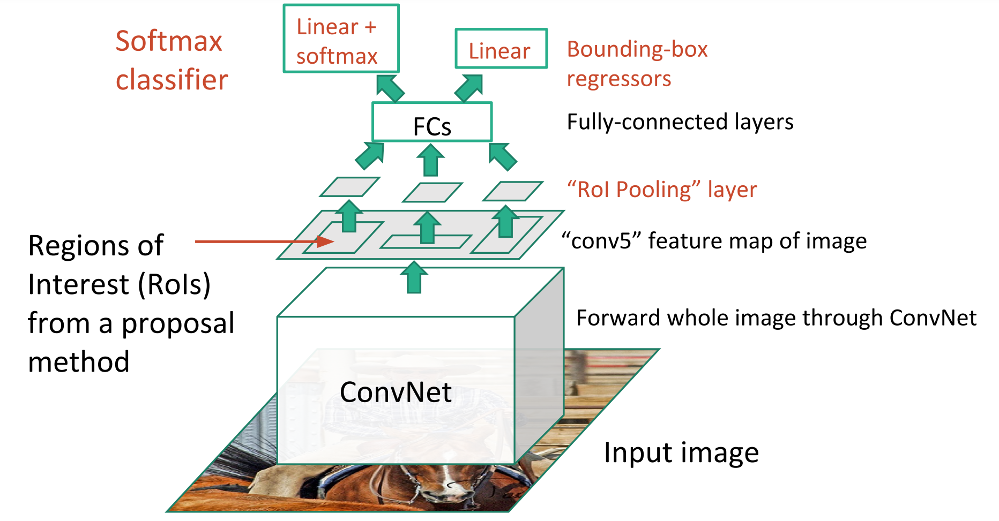
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

#### ROI Pooling

Similar to RCNN, the ROIS have different sizes and need to be resized. But becuase the resolution of the featur map is a lot less than the original image we will use a pooling mthod called __ROI Pooling__. The output of ROI pooling will go through a fully connected layer and then a softmax classifier and a linear regressor for bounding boxes offsets. 

ROI pooling layer divides each projected proposal into a 7x7 grid and then max-pool within each cell.

<br>
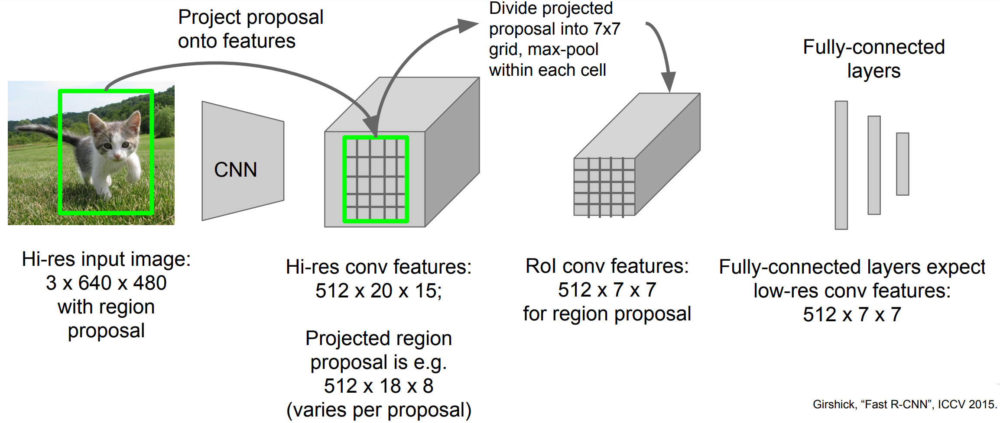
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

#### Training

Fast R-CNN is using a multi-task loss function for training. The CNN weights are initialized from a pre-trained ImageNet classifier except the last fully connected layers that are replaced with two parallel networks for classification and bounding-box regression. 

The loss function is made of two parts:

1. Log of a softmax loss for class prediction
1. Smooth L1 loss for linear regression of bounding box offsets


$$ L(p, c, \Delta^c, v) =  L_{cls}(p, c) + \lambda [c \ge 1] L_{reg}(\Delta^c, v) $$

$$ L_{cls}(p, c) = -log(p_c) $$

$$ L_{reg}(\Delta^c, v) = \sum_{i \in \{x, y, w, h\}} Smooth_{L_1}(\Delta^c_i - v_i) $$

$$ Smooth_{L_1}(x) = \left\{\begin{matrix}
0.5x^2 & if \space | x | < 1\\ 
| x | - 05 & otherwise
\end{matrix}\right. $$


| Symbol | Definition |
|--------------------|--------------------------------|
| $c$ | Ground truth class |
| $v$ | Ground truth bunding-box coordinates |
| $\Delta^c = \\ (\Delta_x^c, \Delta_y^c, \Delta_w^c, \Delta_h^c)$ | Bounding-box offsets |
| $p = (p_0, \dots, p_C)$ | Softmax probabilities for C+1 classes |


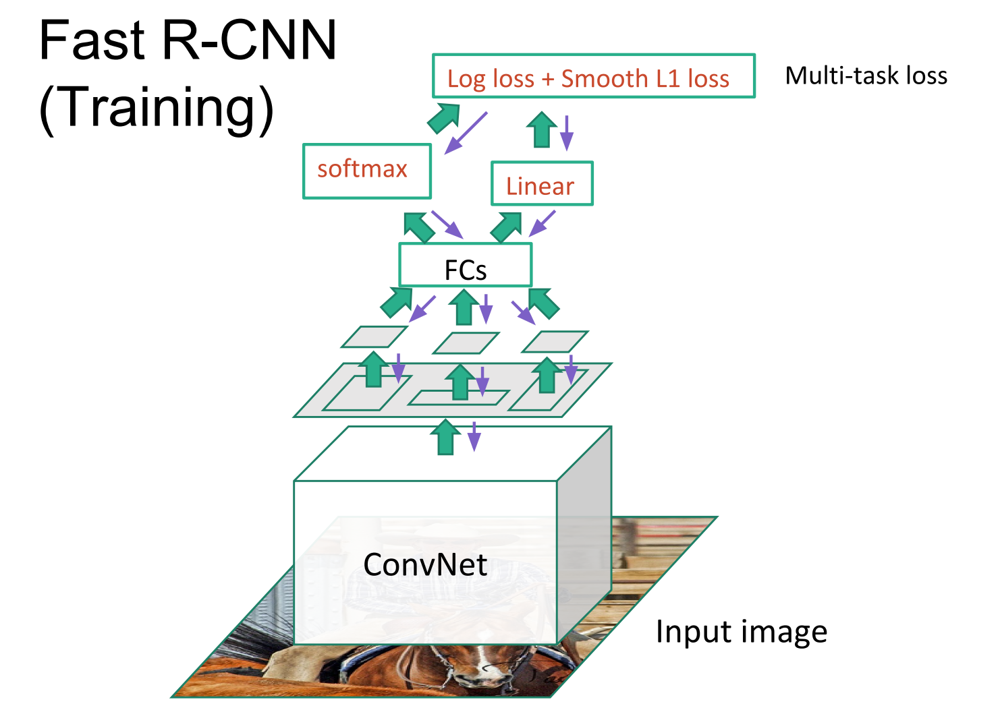
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

<a id="s4.5"></a>
### Faster R-CNN 

Fast R-CNN made a lot of improvement in terms of speed and accuracy of the object detection but it is still relying on traditional region proposal methods. <a href="https://arxiv.org/abs/1506.01497" target="_blank">S. Ren, K. He, R. Girshick, and J. Sun</a> suggested an improved version called Faster R-CNN. 

They introduced a __Region Proposal Network (RPN)__ to predict proposal from the feature map. That eliminates the need for using traditional proposal search method and speeds up the deection because we can use GPU for that.

During the trainig, it learns everything together by minimizing all following four losses jointly:

1. RPN classify object / not object
1. RPN regress box coordinates
1. Final classification score (object classes)
1. Final box coordinates


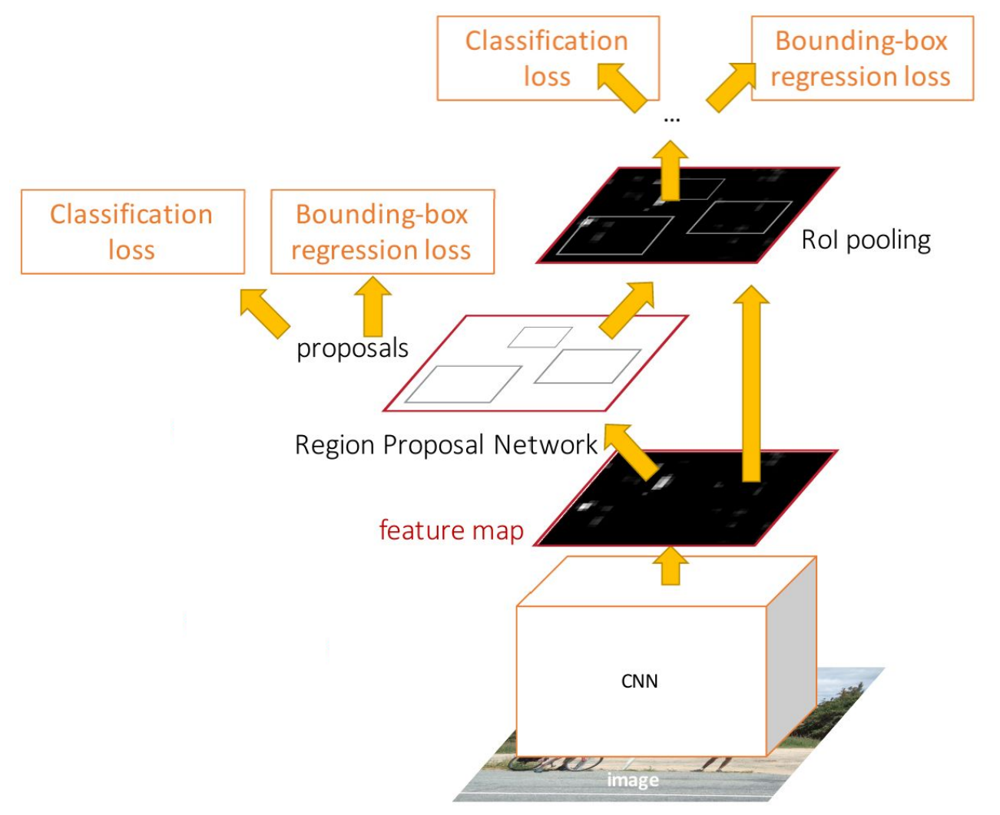
<br><center>Source: Ren et al, “Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks”, NIPS 2015</center>

#### Complete Structure

The following diagram shows the complete structure of Faster R-CNN:
<br><br>
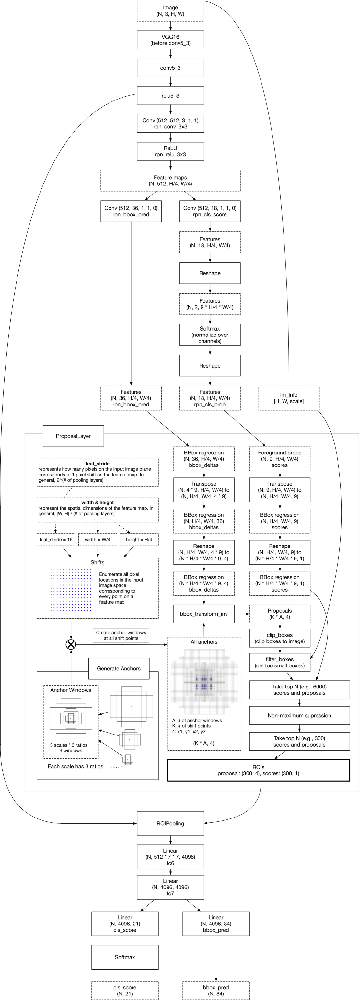
<br><center>Source: L.A. Santos, GitBooks: Artificial Intelligence</center>

#### Speed comparison

The following diagram compares the inference speed of different object detections we discussed so far (we didn't disus SPP-Net). It shows how much it is improved from R-CNN t Faster R-CNN.

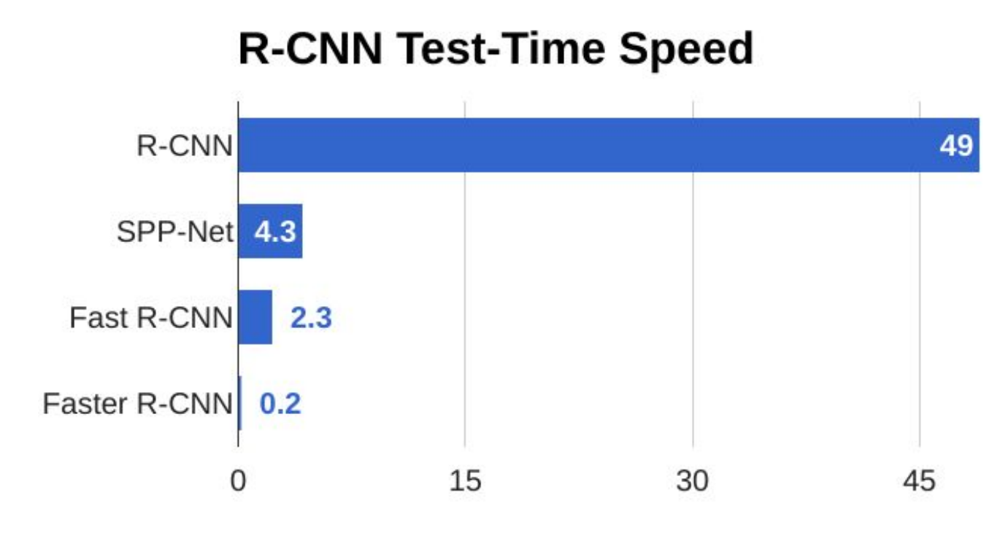
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

<a id="s4.6"></a>
### Mask R-CNN (Object Detection + Instance Segmentation)

__Instance Segmentation__ is an extension of object detection, that associates a binary mask (1 = object, 0 = background) with every bounding box.

<a href="https://arxiv.org/abs/1703.06870" target="_blank">Mask R-CNN</a> ia a simple, flexible, and general framework for object instance segmentation. It extends Faster R-CNN by adding a branch for predicting an object mask in parallel with the existing branch for bounding box recognition. Mask R-CNN is simple to train and adds only a small overhead to Faster R-CNN, running at 5 fps. Moreover, Mask R-CNN is easy to generalize to other tasks, e.g., allowing us to estimate human poses in the same framework.

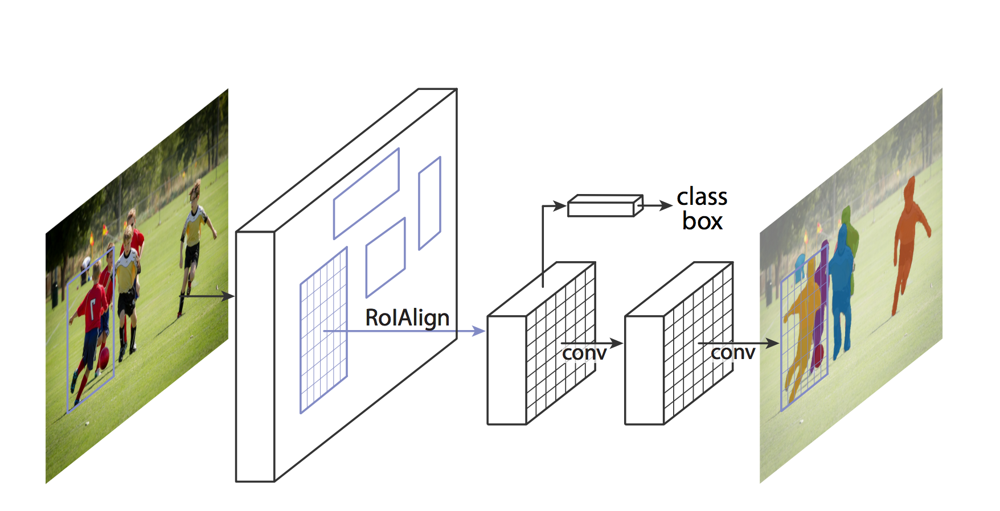
<br><center>Source: K. He, G. Gkioxari, P. Dollar, R. Girshick, Mask R-CNN, 2017</center>

#### ROIAlign

Mask R-CNN adopts the same two-stage procedure, with an identical first stage (which is RPN). In the second stage, in parallel to predicting the class and box offset, Mask R-CNN also outputs a binary mask for each RoI. However,  constructing the mask branch properly is critical for good results. Most importantly, Faster RCNN was not designed for pixel-to-pixel alignment between network inputs and outputs. This is most evident in how RoIPool performs coarse spatial quantization for feature extraction. To fix the misalignment, Mask R-CNN uses a simple, quantization-free layer, called __RoIAlign__, that faithfully preserves exact spatial locations. 

RoIPool first quantizes a floating-number RoI to the discrete granularity of the feature map, this quantized RoI is then subdivided into spatial bins which are themselves quantized, and finally feature values covered by each bin are aggregated (usually by max pooling). RoIAlign layer removes the harsh quantization of RoIPool, properly aligning the extracted features with the input. It avoids any quantization of the RoI boundaries or bins and uses bilinear
interpolation to compute the exact values of the input features at four regularly sampled locations in each
RoI bin, and aggregate the result (using max or average). The following images demostrated the difference bwtweem ROIPool and ROIAlign. 

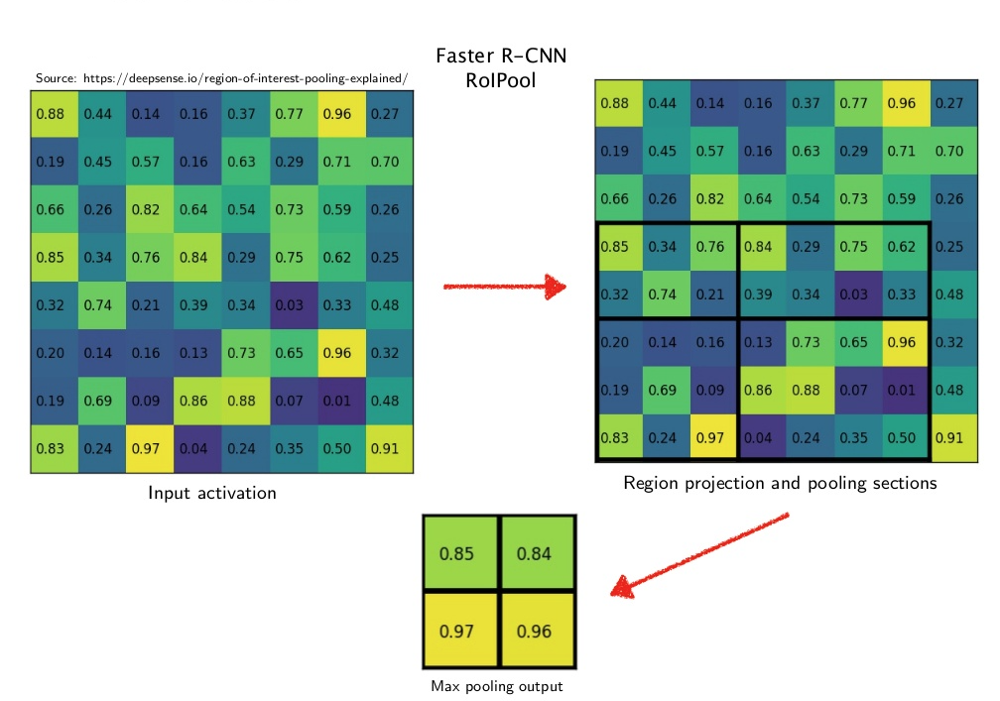

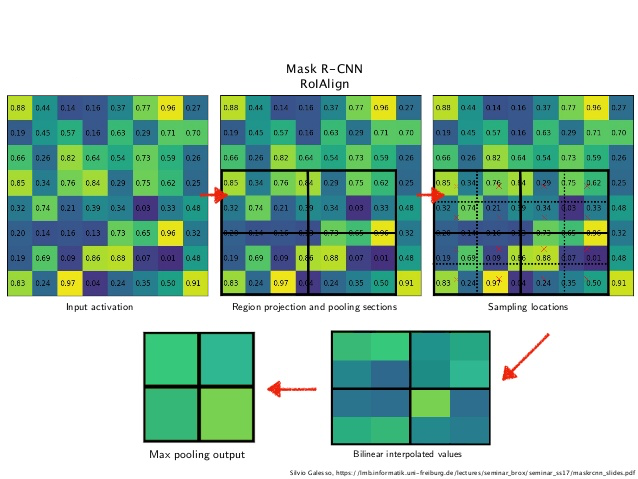

#### Loss Function

Mask R-CNN uses a multi-task loss on each sampled RoI as below:

$$ L = L_{cls} + L_{box} + L_{mask} $$

The classification loss $L_{cls}$ and bounding-box loss $L_{box}$ are identical as those defined in Faster R-CNN. 

The mask branch has a $Km^2$ dimensional output for each RoI, which encodes $K$ binary masks of resolution m × m, one for each of the $K$ classes. A per-pixel sigmoid is applied, and $L_{mask}$ is defined as the average binary cross-entropy loss. For an RoI associated with ground-truth class $k$, $L_{mask}$ is only defined on the $k^{th}$ mask (other mask outputs do not contribute to the loss). The definition of $L_{mask}$ allows the network to generate masks for every class without competition among classes.

#### Results

The results of Mask R-CNN are very good (on COCO dataset) as shown in the image below. These results are based on ResNet-101, achieving a mask AP of 35.7 and running at 5 fps. Masks are shown in color, and bounding box, category, and confidences are also shown.

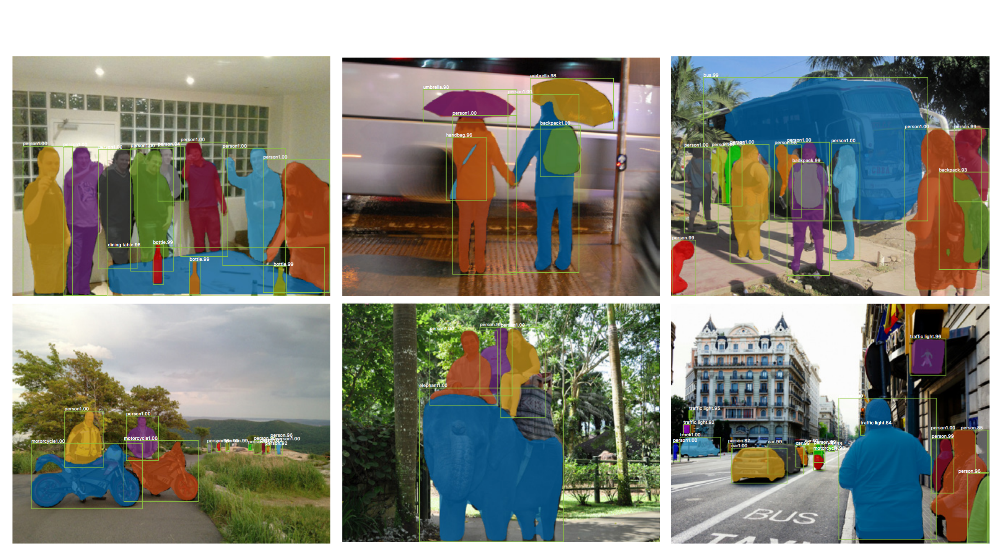
<br><center>Source: K. He, G. Gkioxari, P. Dollar, R. Girshick, Mask R-CNN, 2017</center>

#### Human Pose Estimation

Humen pose estimation is a set of techniques in computer vision with the purpose of detecting human figures in images and/or videos. For example, one can determine where someone’s elbow or arm shows up in an image.

Mask R-CNN can easily be extended to human pose estimation. It models a keypoint’s location as a one-hot mask, and adopt Mask R-CNN to predict $K$ masks, one for each of $K$ keypoint types (e.g., left shoulder, right elbow).

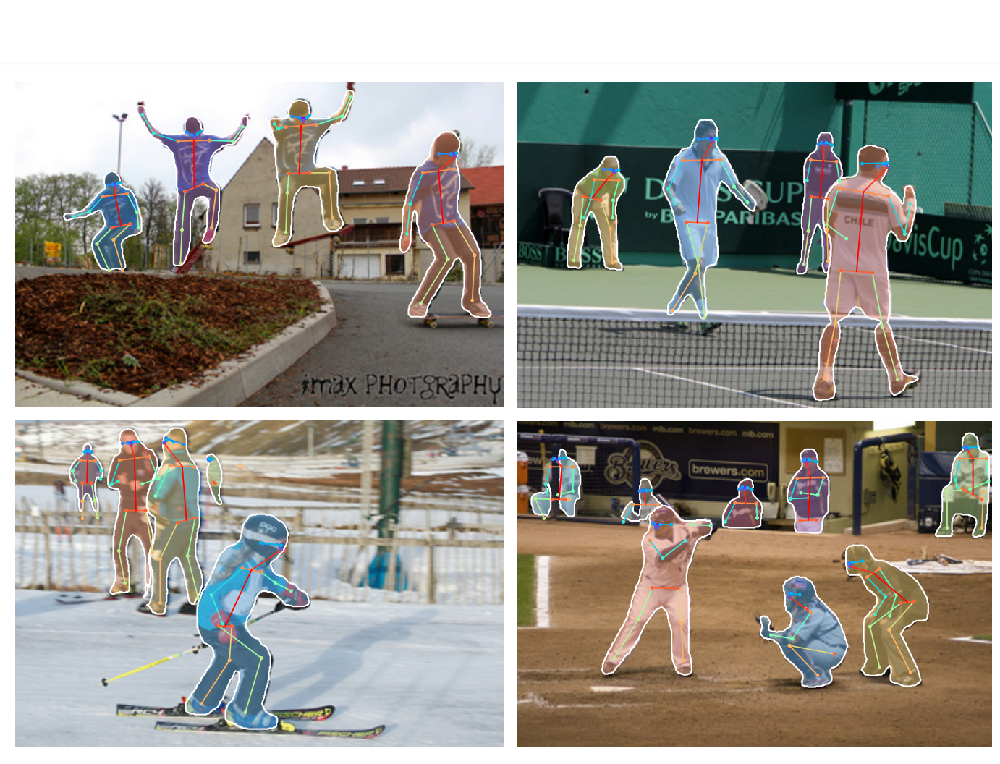
<br><center>Source: K. He, G. Gkioxari, P. Dollar, R. Girshick, Mask R-CNN, 2017</center>

<a id="s4.7"></a>
### Demo: Mask R-CNN

#### Imports

In [11]:
import os
import sys
import random
import math
import numpy as np
import skimage.io
import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

# Import Mask RCNN
from mrcnn import utils, config
import mrcnn.model as modellib
from mrcnn import visualize

# Download COCO trained weights if needed
if not os.path.exists("mask_rcnn_coco.h5"):
    utils.download_trained_weights("mask_rcnn_coco.h5")

#### Create model and load weights

In [12]:
class InferenceConfig(config.Config):
    # Set batch size to 1 since we'll be running inference on
    # one image at a time. Batch size = GPU_COUNT * IMAGES_PER_GPU
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    NAME = "test"
    NUM_CLASSES = 80+1

conf = InferenceConfig()
conf.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [ 0.1  0.1  0.2  0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                93
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE     

In [13]:
# Create model object in inference mode.
model = modellib.MaskRCNN(mode="inference", model_dir=".", config=conf)

# Load weights trained on MS-COCO
model.load_weights("mask_rcnn_coco.h5", by_name=True)

#### Class Names

In [14]:
# COCO Class names
# Index of the class in the list is its ID. For example, to get ID of
# the teddy bear class, use: class_names.index('teddy bear')
class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
               'bus', 'train', 'truck', 'boat', 'traffic light',
               'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']

#### Object detection 

Processing 1 images
image                    shape: (491, 640, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


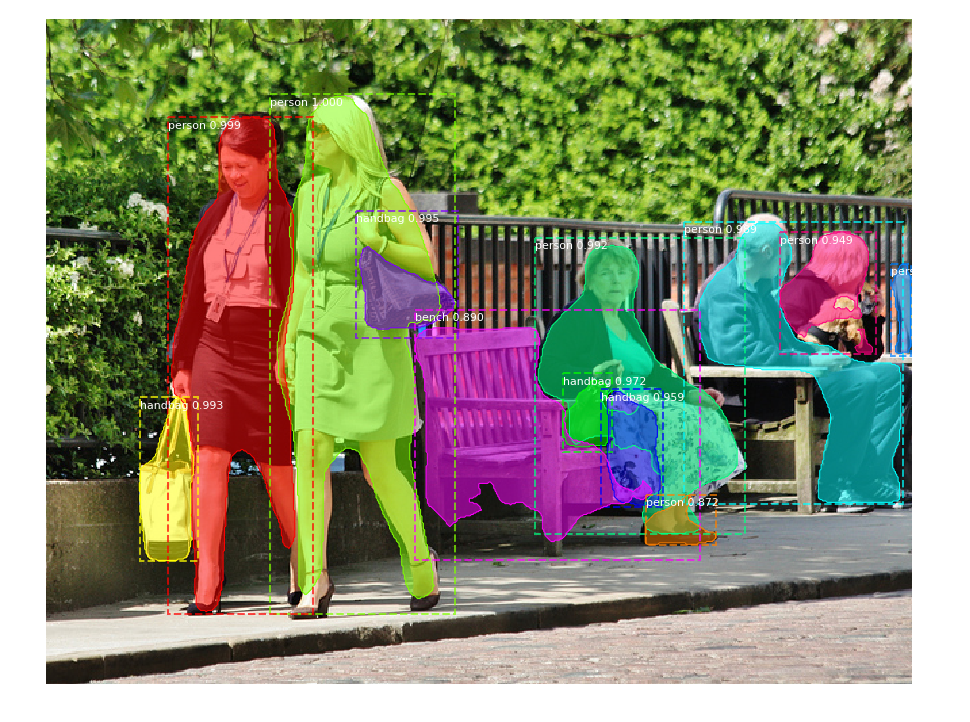

In [15]:
# Load an image
file_name = 'mrcnn/image_1.jpg'
image = skimage.io.imread(file_name)

# Run detection
results = model.detect([image], verbose=1)

# Visualize results
r = results[0]
visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                            class_names, r['scores'])

<a id="s4.8"></a>
### Single Shot Detectors

So far we discussed R-CNN methods of object detection that all use region proposals followed by a high quality classifier to classify these proposals. These methods are accurate but come at a big computational cost (low frame-rate), in other words they are not fit to be used on embedded devices and for real-time applications.

Another type of object detectors are __Single Shot Detctors__ that combine the above two tasks into one network. They use a set of pre-defined boxes to look for objects instead of having a network produce proposals. Using convolutional features maps from later layers of a network they run small CONV filters over these features maps to predict class scores and bounding box offsets.

The main idea is that instead of using prposal methods we will run a small convolutional network over the feature maps from later layers of the main CNN to predict class scores and bounding box offsets.

There are two main architecture of this type:

1. YOLO
1. SSD


<a id="s4.9"></a>
### YOLO

YOLO (You Only Look Once) was suggested by <a href="https://arxiv.org/abs/1506.02640" target="_blank">J. Redman et al.</a> as a new approach to object detection. Their base network runs at 45 frames per second with no batch processing on a Titan X
GPU and a fast version runs at more than 150 fps while keeping the accuracy competitive. 

The idea of this detector is that you run the image on a CNN model and get the detection on a single pass. First the image is resized to 448x448, then fed to the network and finally the output is filtered by a Non-max suppression algorithm.
<br><br>
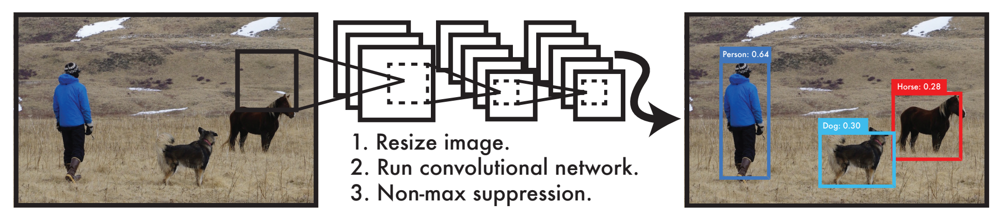
<br><center>Source: J. Redmon, S. Divvala, R. Girshick, A. Farhadi, You Only Look Once: Unified, Real-Time Object Detection, 2015</center>

YOLO's detection network has 24 convolutional layers followed by 2 fully connected layers. Alternating 1 × 1 convolutional layers reduce the features space from preceding layers. Convolutional layers are pre-trained on the ImageNet classification task at half the resolution (224 × 224 input image) and then double the resolution for detection.


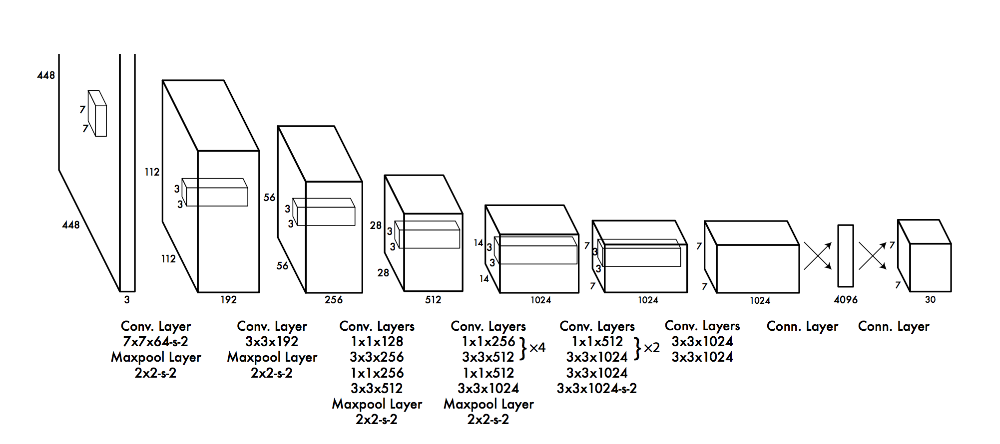
<br><center>Source: J. Redmon, S. Divvala, R. Girshick, A. Farhadi, You Only Look Once: Unified, Real-Time Object Detection, 2015</center>

YOLO models detection as a regression problem. It divides the image into an S × S grid and for each grid cell predicts B bounding boxes, confidence for those boxes, and C class probabilities. These predictions are encoded as an S × S × (B ∗ 5 + C) tensor.

Each bounding box consists of 5 predictions: x, y, w, h, and confidence. The (x, y) coordinates represent the center
of the box relative to the bounds of the grid cell. The width and height are predicted relative to the whole image. Finally the confidence prediction represents the IOU between the predicted box and any ground truth box. Formally, confidence is defined as :

$$ Pr(Object) ∗ IOU^{truth}_{pred} $$ 

Each grid cell also predicts C conditional class probabilities, Pr(Classi|Object). These probabilities are conditioned
on the grid cell containing an object. Only one set of class probabilities per grid cell is predicted, regardless of the number of boxes B. At test time, the conditional class probabilities and the individual box confidence predictions are multiplied which gives class-specific confidence scores for each box:

$$ Pr(Class_i|Object) ∗ Pr(Object) ∗ IOU^{truth}_{pred} = Pr(Class_i) ∗ IOU^{truth}_{pred} $$ 


These scores encode both the probability of that class appearing in the box and how well the predicted box fits the object.

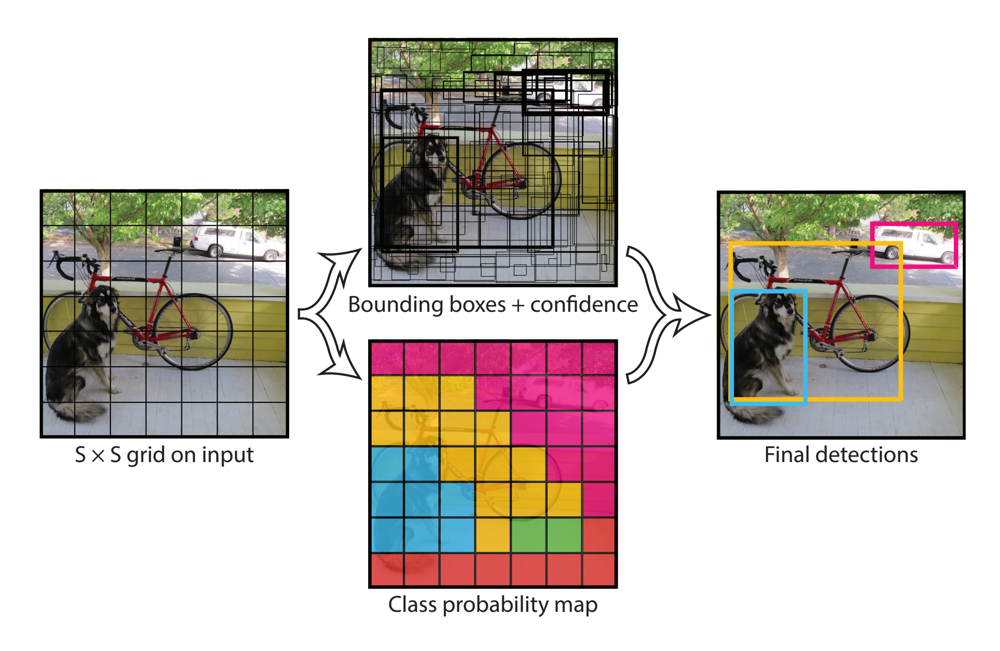
<br><center>Source: J. Redmon, S. Divvala, R. Girshick, A. Farhadi, You Only Look Once: Unified, Real-Time Object Detection, 2015</center>

For eaxmple the following image shows how the input image is divided to 7x7 grid (S = 7) and for each cell we predict 3 (B = 3) bounding boxes (One square, one portrait, and one landscape). The original Yolo was trained for 20 classes (C =20), therefore the output has a shape of 7x7x(3x5+20). 

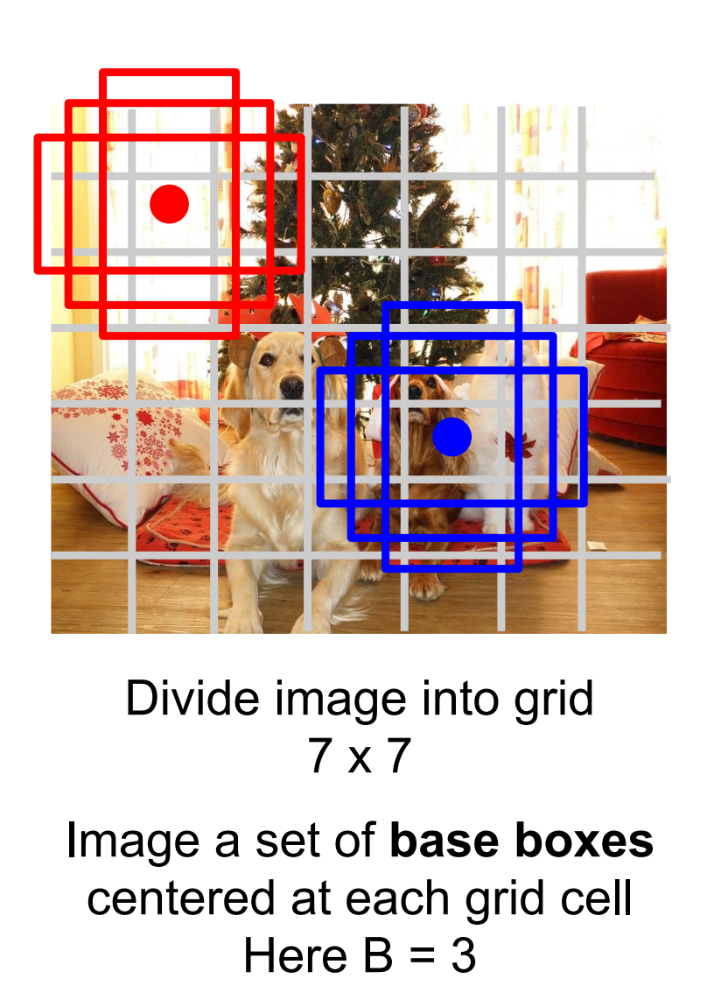
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

YOLO also has a multi-part loss function. This loss function takes into account the following objectives:

1. Classification (20 classes)
1. Object/No object classification
1. Bounding box coordinates (x,y,height,width) regression (4 scalars)


Each of this sub-objectives use a sum-squared error, also a factor and are used to unbalance the box coordinates and the classification objectives.

It is also important to note that:

1. The classification loss is not back propagated if the cell has no object
1. The bounding box loss with highest IOU with the ground truth is backpropagated

<br><br>
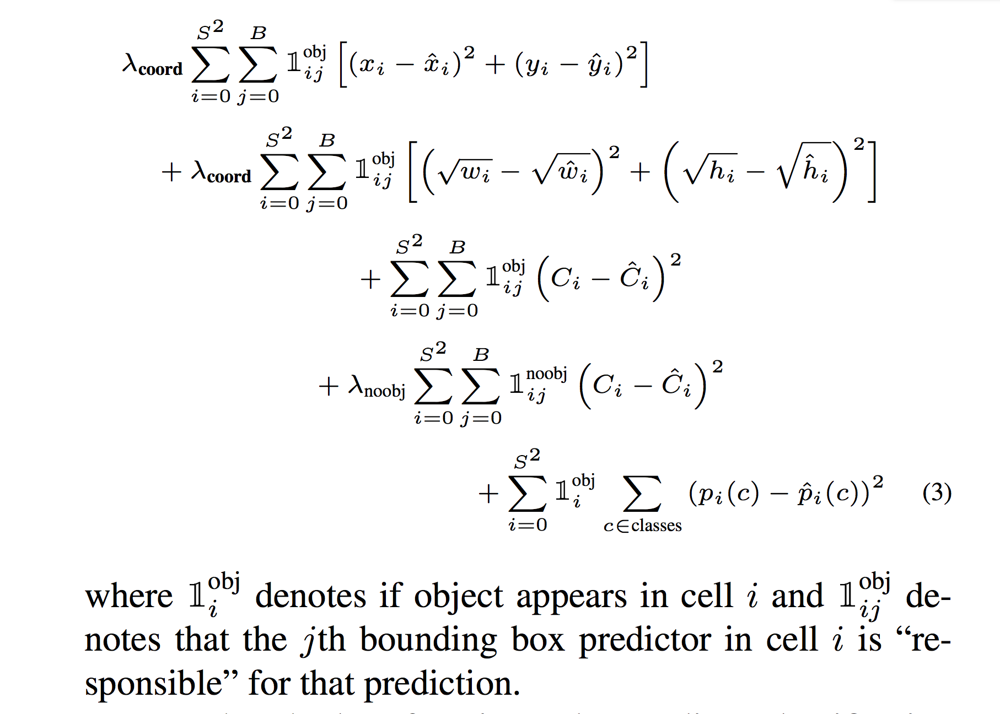
<br><center>Source: J. Redmon, S. Divvala, R. Girshick, A. Farhadi, You Only Look Once: Unified, Real-Time Object Detection, 2015</center>


<a id="s4.10"></a>
### SSD

SSD was introduced by <a href="https://arxiv.org/abs/1512.02325" target="_blank">W. Liu et al</a>. It differs from YOLO because of using multiple layers (instead of using last year) that provide a finer accuracy on objects with different scales. (Each deeper layer will see bigger objects). The following diagram comapres the two architectures. 

The base of SSD normally is a VGG or Resnet pre-trained model that is converted to a fully convolution neural network. Then some extra conv layers are attached, which will actually help to handle bigger objects. The SSD architecture can in principle be used with any deep network base model.


<br><br>
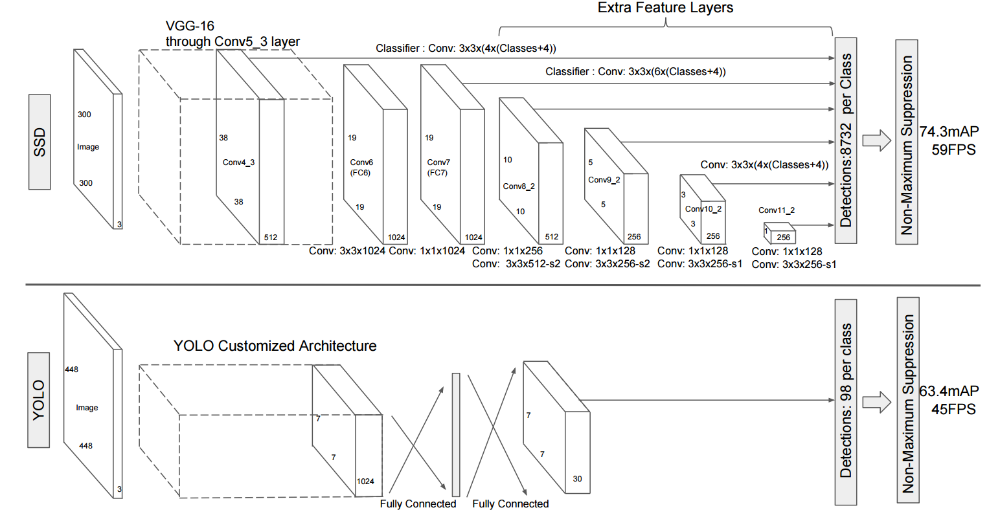
<br><center>Source: W. Liu, D. Anguelov, D. Erhan, C. Szegedy, S. Reed, C. Fu, A. C. Berg, SSD: Single Shot MultiBox Detector, 2015</center>

The follwoing images shows the default bounding boxes. SSD only needs an input image and ground truth boxes for each object during training. In a convolutional fashion, a small set (e.g. 4) of default boxes of different aspect ratios at each location in several feature maps with different scales (e.g. 8 × 8 and 4 × 4 in (b) and (c)) is evaluated. For each default box, both the shape offsets and the confidences for all object categories ((c1, c2, · · · , cp)) are predicted. 


At training time, first these default boxes are matched to the ground truth boxes. For example, in teh image, two default boxes with the cat and one with the dog are matched, which are treated as positives and the rest as negatives. 

<br><br>
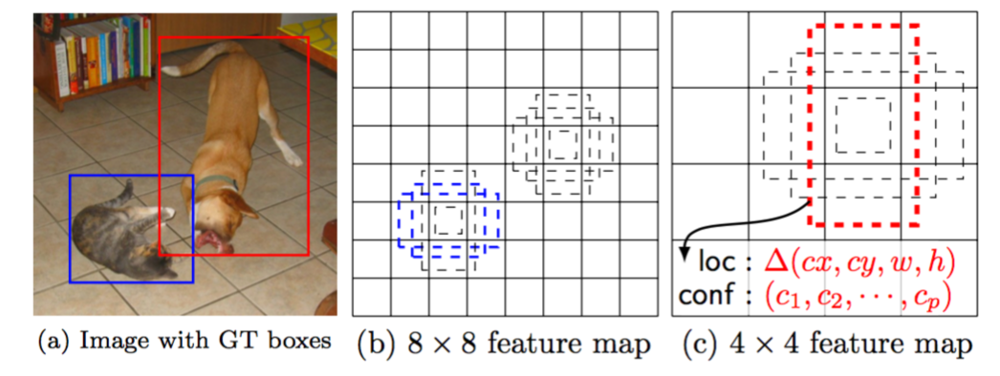
<br><center>Source: W. Liu, D. Anguelov, D. Erhan, C. Szegedy, S. Reed, C. Fu, A. C. Berg, SSD: Single Shot MultiBox Detector, 2015</center>

The model loss is a weighted sum between localization loss (e.g. Smooth L1) and confidence loss (e.g. Softmax): (N is the number of matched default boxes)

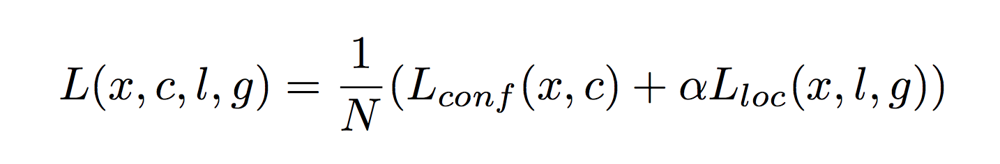
<br><center>Source: W. Liu, D. Anguelov, D. Erhan, C. Szegedy, S. Reed, C. Fu, A. C. Berg, SSD: Single Shot MultiBox Detector, 2015</center>

The localization loss is a Smooth L1 loss between the predicted box ($l$) and the ground truth box ($g$) parameters. Similar to Faster R-CNN, we regress to offsets for the center ($cx$, $cy$) of the default bounding box ($d$) and for its width ($w$) and height ($h$).


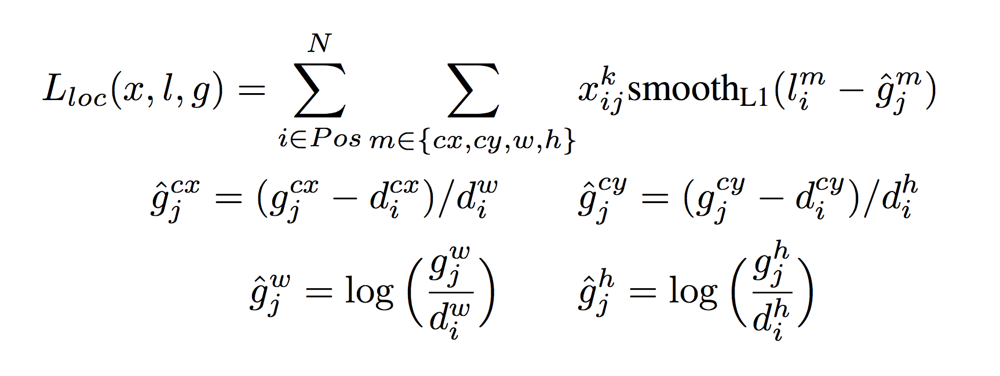
<br><center>Source: W. Liu, D. Anguelov, D. Erhan, C. Szegedy, S. Reed, C. Fu, A. C. Berg, SSD: Single Shot MultiBox Detector, 2015</center>

The confidence loss is the softmax loss over multiple classes confidences ($c$) and the weight term $\alpha$ is set to 1 based on the result of cross validation.

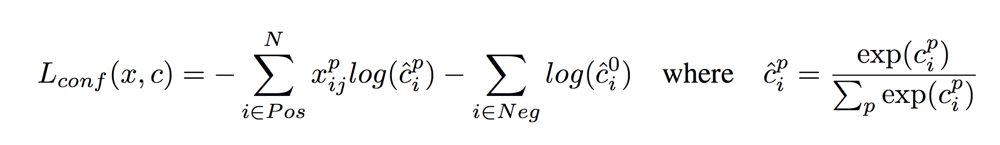
<br><center>Source: W. Liu, D. Anguelov, D. Erhan, C. Szegedy, S. Reed, C. Fu, A. C. Berg, SSD: Single Shot MultiBox Detector, 2015</center>

<a id="s4.11"></a>
### Speed / Accuracy Comparison of Object Detectors

A paper from <a href="https://arxiv.org/abs/1611.10012" target="_blank">Google Research</a> is comparing speed/accuracy trade-offs for modern convolutional object detectors. The following diagram summerizes their finding. We can see that models with Regional Proposal Networks (e.g. Faster R-CNN) have the potential for higher accuracy, especially using more complex CNN and higher number of box proposals, but in expense of speed. Single shot detectors are much faster but have lower accuracy, especially for small objects. This is still an active area of research and both type of deectors are being improved in both accuracy and speed.   

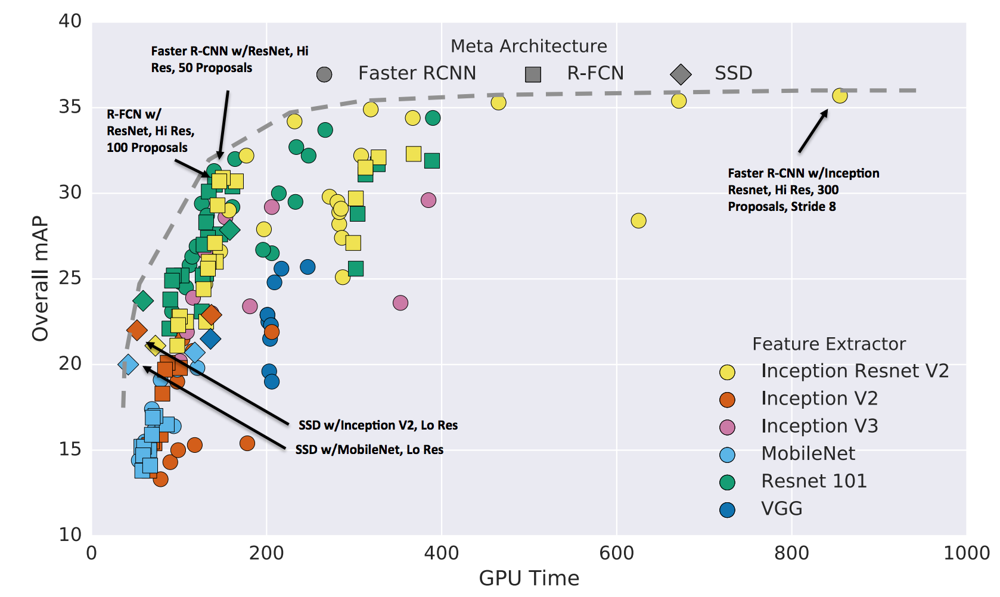
<br><center>Source: J. Huang, V. Rathod, C. Sun, M. Zhu, A. Korattikara, A. Fathi, I. Fischer, Z. Wojna, Y. Song, S. Guadarrama, K. Murphy, Speed/accuracy trade-offs for modern convolutional object detectors, 2017</center>

<a id="s4.12"></a>
### Impact of Deep Learning on Object Detection

The following digram shows the impact of deep learning on teh task of detection object in images. It is reporting the best accuracy achived on <a href="http://host.robots.ox.ac.uk/pascal/VOC/" target="_blank">Pascal VOC</a> by year. Before 2013 (the introduction of deep learning for object detection), we can see there is a plateau but after 2013 there is an exponeential increase in accuracy.   

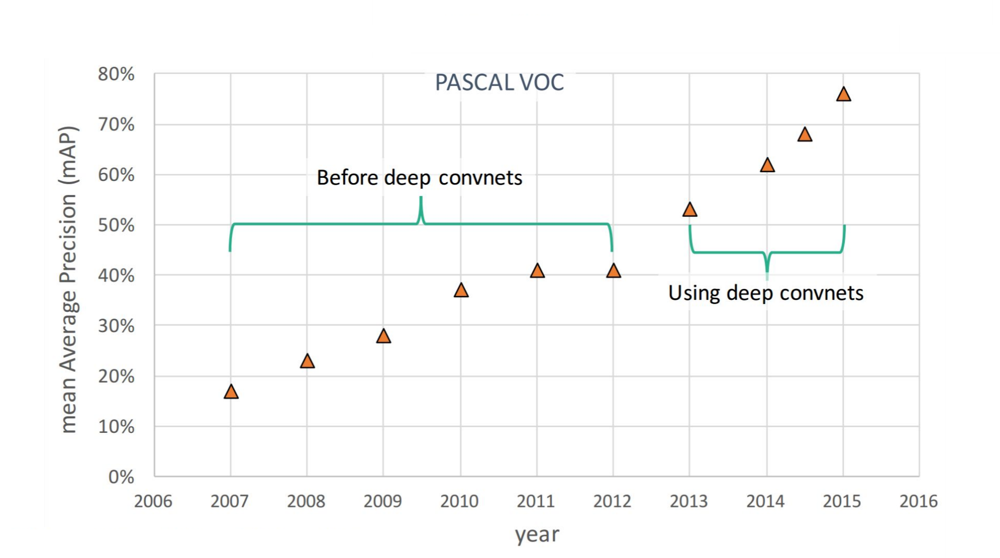
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

<a id="s4.13"></a>
### Tensorflow Object Detection API

The <a href="https://github.com/tensorflow/models/tree/master/research/object_detection" target="_blank">TensorFlow Object Detection API</a> is an open source framework built on top of TensorFlow that makes it easy to construct, train and deploy object detection models.

<a id="s5"></a>
## Semantic Segmentation

This is the task to label each pixel in an image with a category/class label. We don’t differentiate instances, only care about pixels. This is very different thatn object detection because we are not looking for the bounding boxes and their classes but we want to classify each pixel.

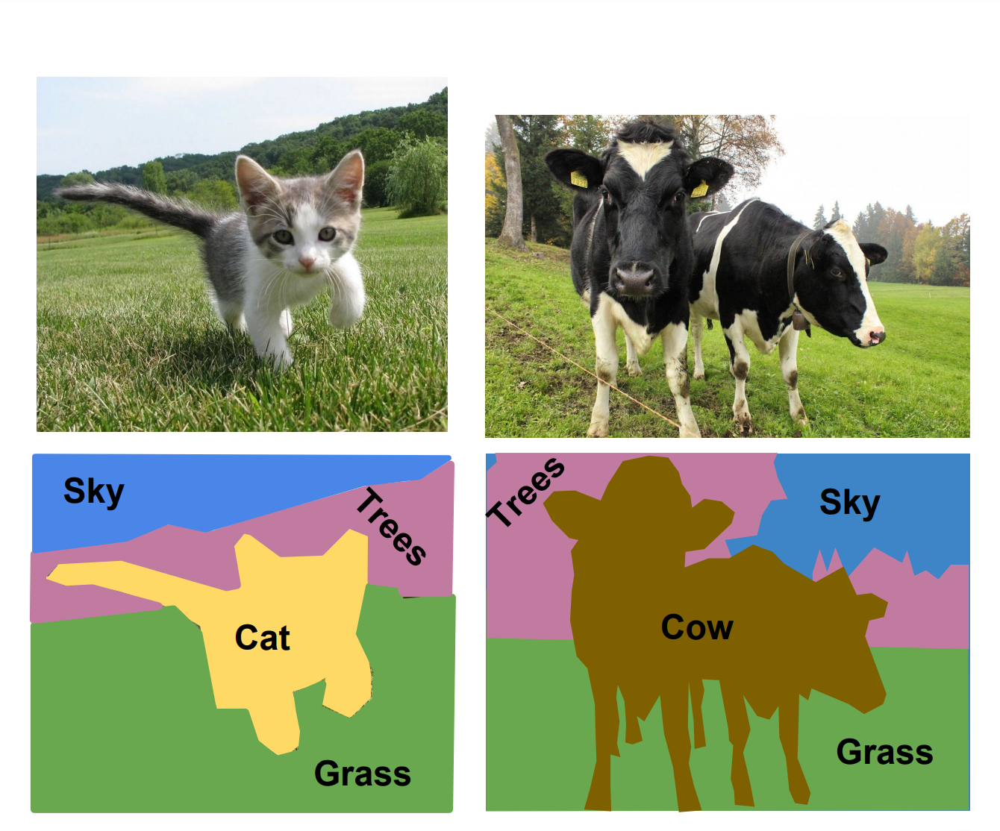
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

<a id="s5.1"></a>
### Sliding Window Approach

Similar to object detection, one naive approach is the sliding window approach. In this approach, we will extract a square patch (window) around each pixel. Then we use a CNN classifier to classify the object in the window. This class will be assigned to the corresponding pixel. It is important to note that we have to fine-tune the CNN to classify the objects from some patches of them. 

The obvious issue with this approach is lack of efficiency. We have to run as many patches as the number of pixels through a CNN. That means we are repeating the calculations for overlapping parts of the windows. 

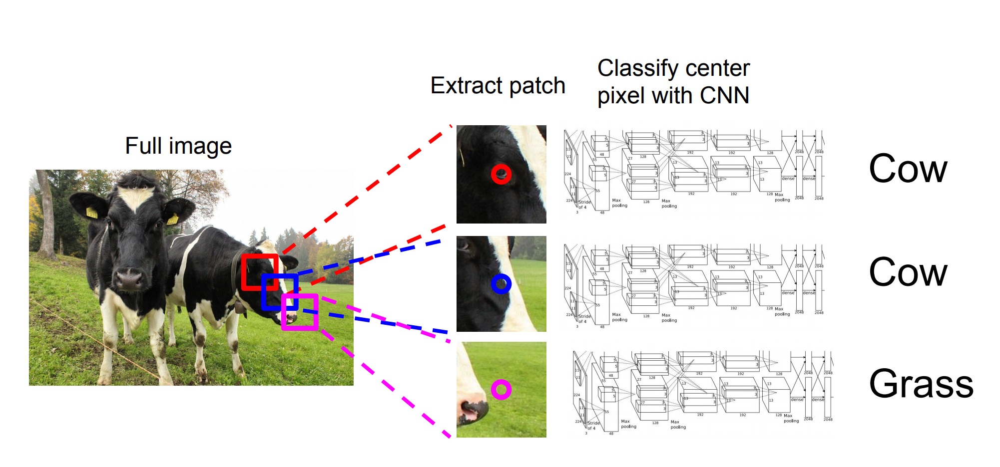
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

<a id="s5.2"></a>
### Fully Convolutional Networks (FCN) for Semantic Segmentation

One idea to fix the inefficiency of the sliding window method is to use one fully convolutional network to map from the input image to a segmented image as the output. The following diagram shows the idea. However, convolutions at original image resolution will be very expensive. In regular CNNs the resolution is reduced as it goes deeper in the network.  

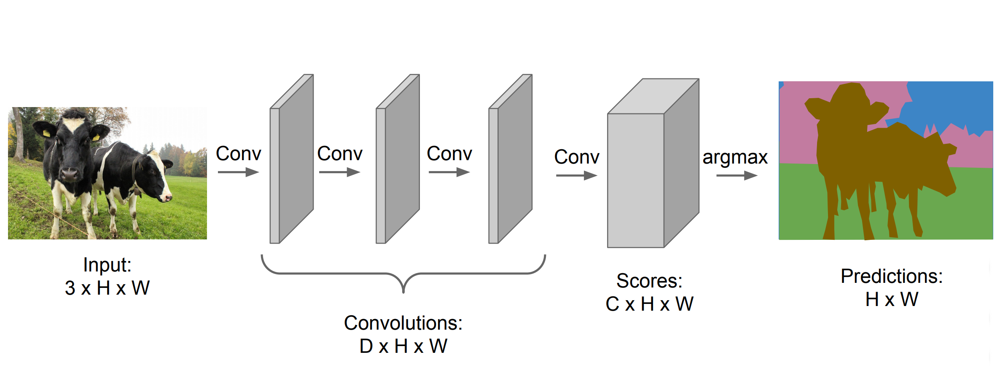
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

<a href="https://arxiv.org/abs/1411.4038" target="_blank">J. Long et al.</a> introduces a fully convolutional network (FCN) to fix the above issue. FCN is a normal CNN, where the last fully connected layer is substituted by another convolution layer with a large "receptive field". FCN adapts and extends deep classification architectures, using image classification as supervised pre-training, and fine-tune fully convolutionally to learn simply and efficiently from whole image inputs and whole image ground thruths. 

The course outputs of the classifier CNN (e.g. AlexNet) is connected to dense pixels thruugh interpolation a.k.a. upsampling. A natural way to upsample is backwards convolution (sometimes called deconvolution wrongly). 

Here are the steps to convert a CNN classifier to FCN (for Pascal classes):

1. We begin by a convolutionalizing proven classification architecture like AlexNet, VGG, GoogLeNet, and so on.
1. We decapitate each net by discarding the final classifier layer, and convert all fully connected layers to convolutions. 
1. We append a 1 × 1 convolution with channel dimension 21 to predict scores for each of the PASCAL classes (including background) at each of the coarse output locations, followed by a backward convolution layer to bilinearly upsample the coarse outputs to pixel-dense outputs. 


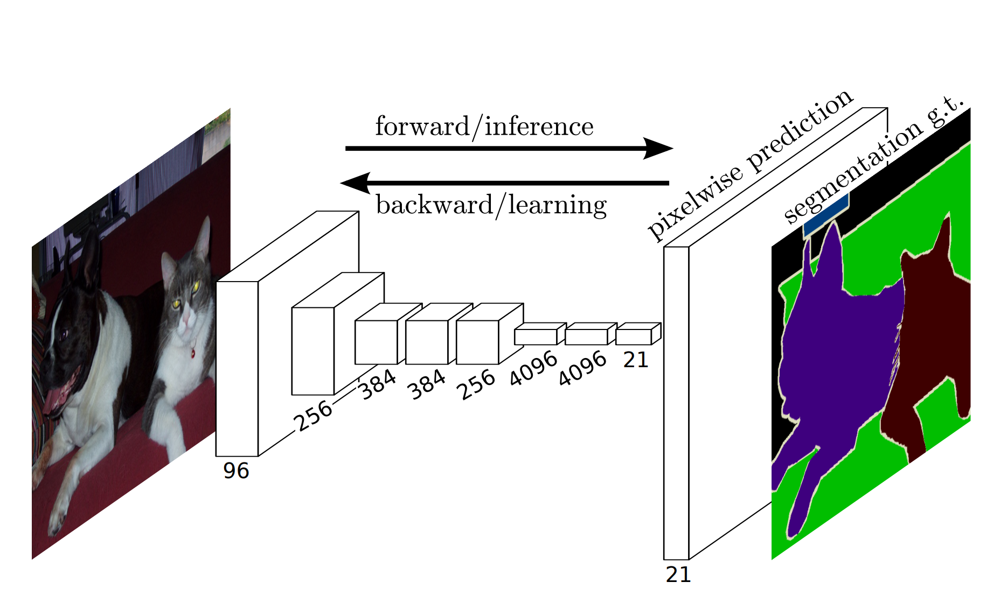
<br><center>Source: J. Long, E. Shelhamer, T. Darrell, Fully Convolutional Networks for Semantic Segmentation, 2015</center>

The suggested FCN worked reasonably but having one backward convolutional layer on top of CNN seemed to be inadequate. Therefore, <a href="https://arxiv.org/abs/1505.04366" target="_blank">H. Noh et al.</a> suggested to learn d full backward convolutional network (deconvolutional network) on top of the convolutional layers adopted from VGG 16-layer net. The deconvolution network is composed of deconvolution and unpooling layers, which identify pixel-wise class labels and predict segmentation masks. Given a feature representation obtained from the convolution network, dense pixel-wise class prediction map is constructed through multiple series of unpooling, deconvolution and rectification operations.


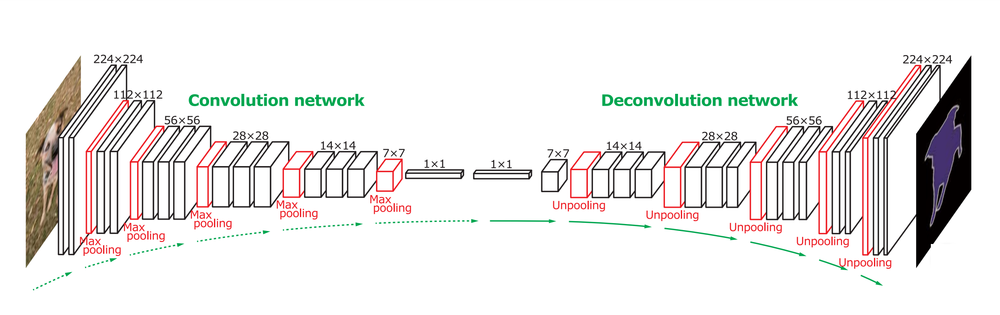
<br><center>Source: H. Noh, S. Hong, B. Han, Learning Deconvolution Network for Semantic Segmentation, 2015</center>

#### Unpooling & Deconvolution

Pooling in convolution network is designed to filter noisy activations in a lower layer by abstracting activations in a receptive field with a single representative value. Although it helps classification by retaining only robust activations in upper layers, spatial information within a receptive field is lost during pooling, which may be critical for precise localization that is required for semantic segmentation. To resolve such issue, unpooling layers in deconvolution network are employed, which perform the reverse operation of pooling and reconstruct the original size of activations as illustrated in image below.

The output of an unpooling layer is an enlarged, yet sparse activation map. The deconvolution layers densify the sparse activations obtained by unpooling through convolution-like operations with multiple learned filters. However, contrary to convolutional layers, which connect multiple input activations within a filter window to a single activation, deconvolutional layers associate a single input activation with multiple outputs, as also illustrated in image below. 

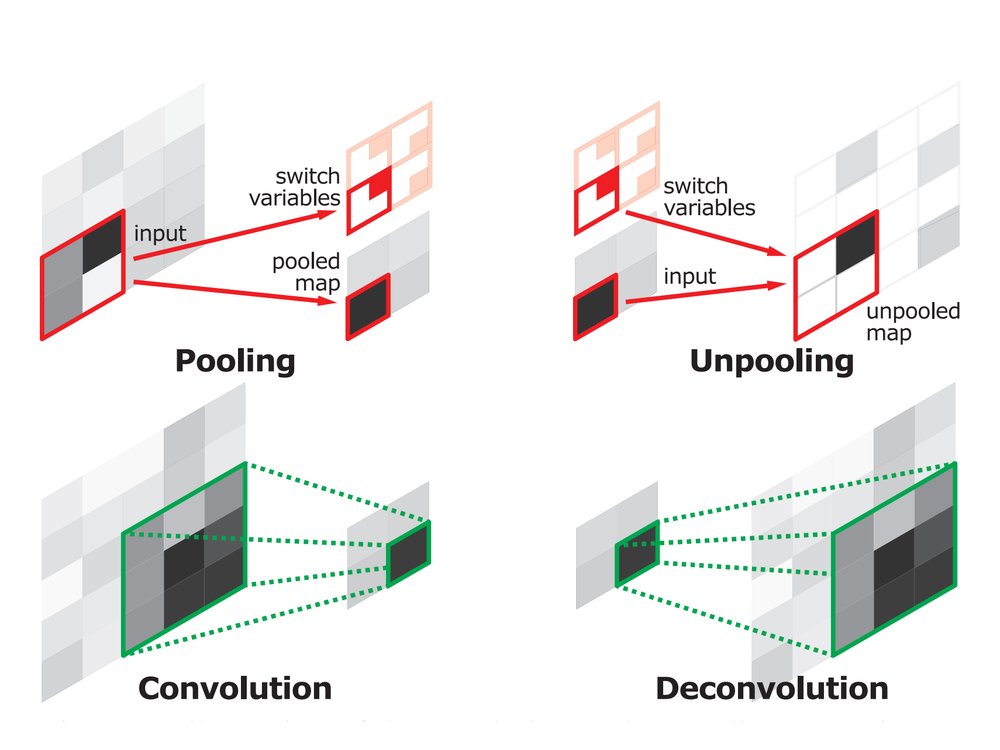
<br><center>Source: H. Noh, S. Hong, B. Han, Learning Deconvolution Network for Semantic Segmentation, 2015</center>

To understand it better, the following image shows an example of how deconvolution (upsampling) for 1D tensor works. It works the same way for 2D tansors.

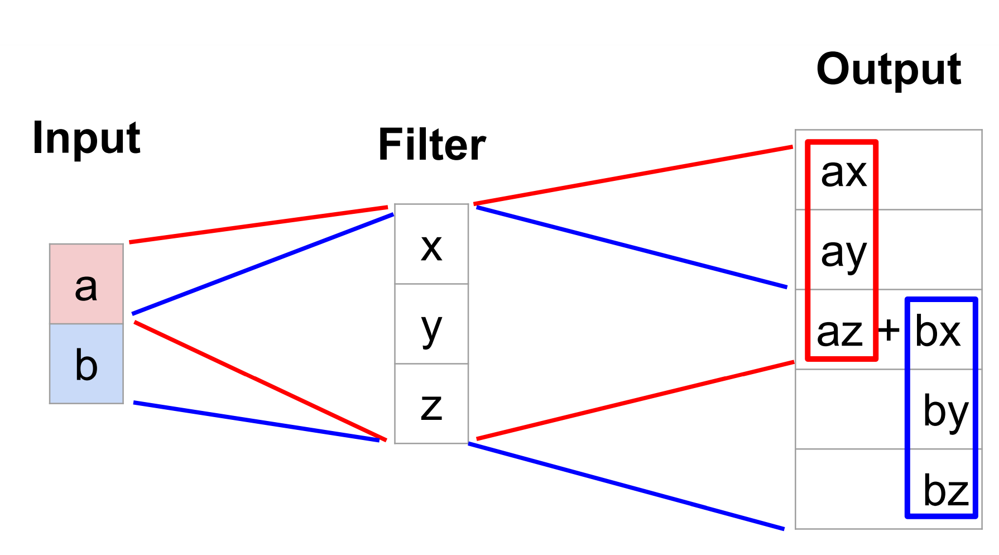
<br><center>Source: Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</center>

#### Training 

The new network is very deep (almost twice deeper than FCN) and contains a lot of associated parameters. In addition, the number of training examples for semantic segmentation is relatively small compared to the size of the network (12031 PASCAL training and validation images in total). Training a deep network with a limited number of examples is not trivial but it was done using some ideas including batch normalization and two-stage training. The training is done first with easy examples and fine-tuned with more challenging examples later. To construct training examples for the first stage training, the object instances are cropped using ground-truth annotations so that an object is centered at the cropped bounding box


#### Comparison

The following image comapres the results of this new network and FCN. It shows how the results are improved.

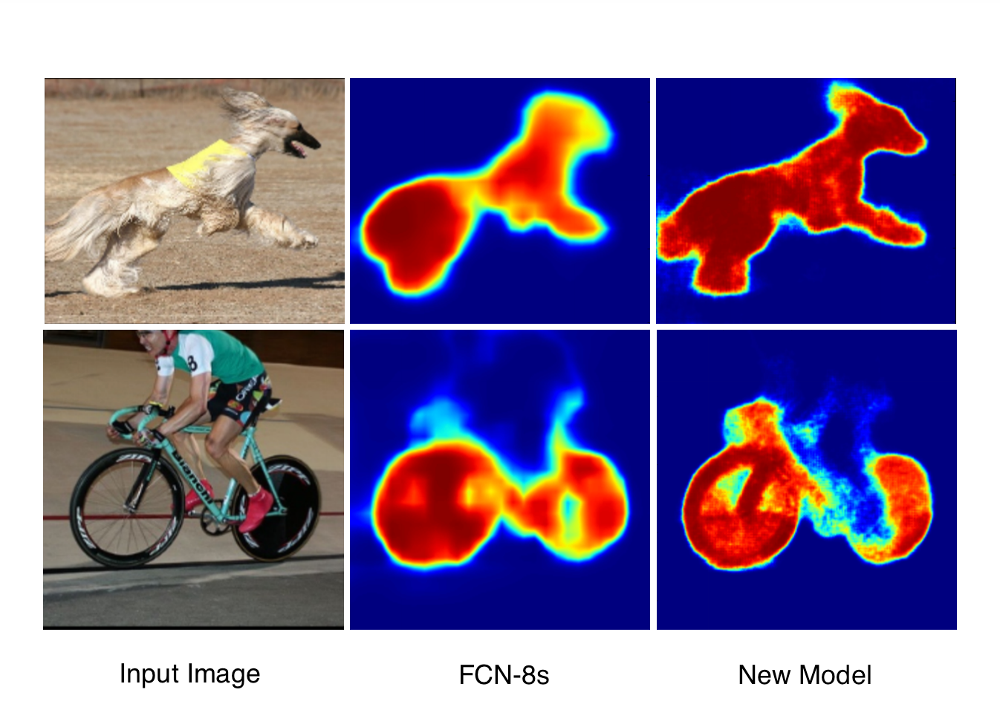
<br><center>Source: H. Noh, S. Hong, B. Han, Learning Deconvolution Network for Semantic Segmentation, 2015</center>

<a id="s5.3"></a>
### U-Net

One practical use of semantivc segmentation is in Biomedical Image Segmentation. <a href="https://arxiv.org/abs/1505.04597" target="_target">U-Net</a> is a convolutional network for the same purpose that is using similar convolution-deconvolution (a.k.a. encoder-decoder) architecture. The following digram shows the architecture of the newtork:

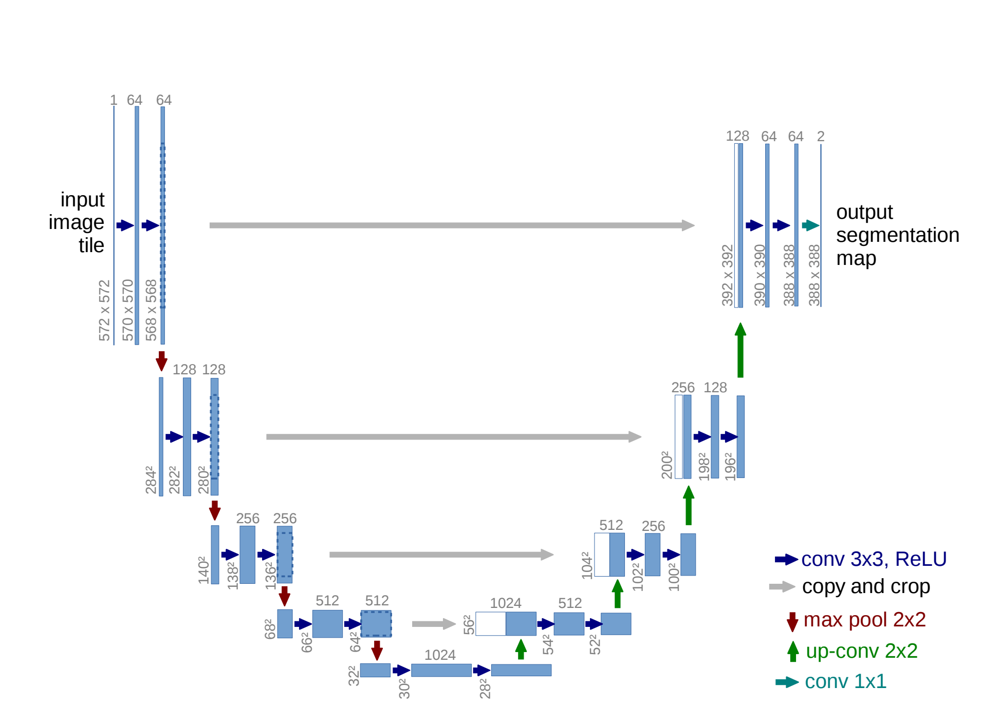
<br><center>Source: O. Ronneberger, P. Fischer, T. Brox, U-Net: Convolutional Networks for Biomedical Image Segmentation, 2015</center>

The following image shows two samples of biomedical image segmented using U-Net: 

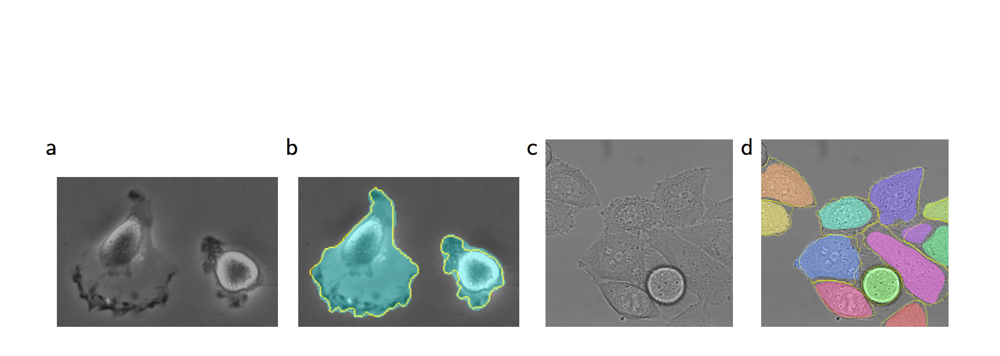
<br><center>Source: O. Ronneberger, P. Fischer, T. Brox, U-Net: Convolutional Networks for Biomedical Image Segmentation, 2015</center>

<a id="s5.4"></a>
### Real-time Semantic Segmentation

Semantic segmentation is used in many applications e.g. automatic driving, robotic interaction, online video processing, and even mobile computing where running time becomes a critical factor. Therefore, fast or real-time semantic segmentation is increasingly becomeing important. 

There are many models for semenatic segmentation, that some of them we have reviewed in this lecture. But not all of them are approperiate for real-time applications. The following diagram comapres the accuarcy vs. speed of the  existing models.

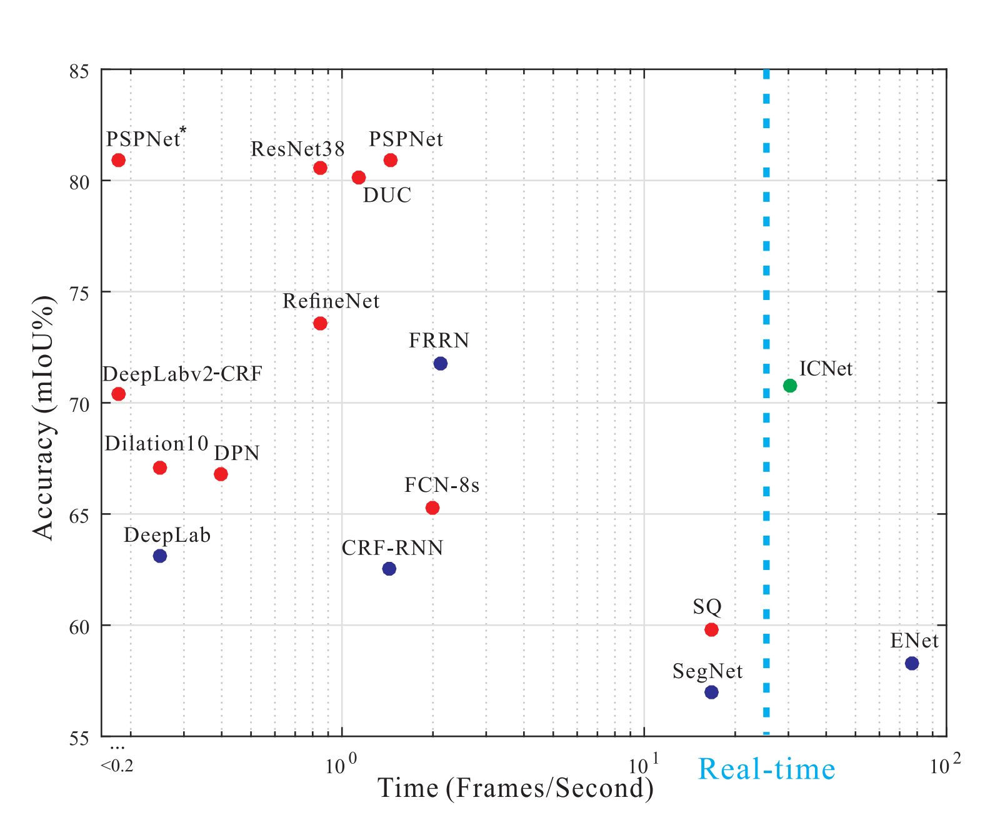
<br><center>Source: H. Zhao, X. Qi, X. Shen, J. Shi, J. Jia, ICNet for Real-Time Semantic Segmentation on High-Resolution Images, 2017</center>

As shown in the diagram, <a href="https://arxiv.org/abs/1704.08545" target="_blank">ICNet (Image Cascade Network)</a> offers the best trade-off between accuracy and speed and is good for real-time applications. ICNet adopts intuitive speedup strategies including downsampling input, shrinking feature maps and conducting model compression.

Segmenting the high-resolution input with classical frameworks like FCN directly is time consuming. However, downsampling the input results in very coarse prediction maps. To overcome this shortcoming, ICNet gets semantic extraction a using low-resolution input as shown in the diagram below. A $\frac{1}{4}$ sized image is fed into PSPNet (a very accurate but slow model) with downsampling rate 8, resulting in a $\frac{1}{32}$-resolution feature map. To get high quality segmentation, medium and high resolution branches (middle and bottom parts in diagram) help recover and refine the coarse prediction. Though some details are missing and blurry boundaries are generated in the top branch, it already harvests most semantic parts. Thus we can safely limit the number of parameters in both middle and bottom branches. Light weighted CNNs (green dotted box) are adopted in higher resolution branches; different-branch output feature maps are fused by cascade-feature-fusion (CFF) unit and trained with cascade label guidance (CLG). For more details about CFF and CLG, refer to the ooriginal paper <a href="https://arxiv.org/abs/1704.08545" target="_blank">here</a>.  


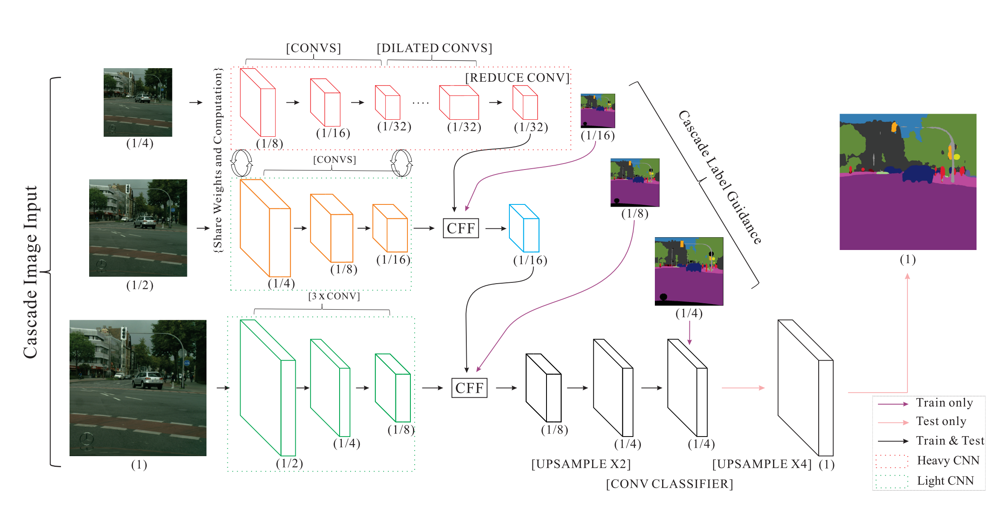
<br><center>Source: H. Zhao, X. Qi, X. Shen, J. Shi, J. Jia, ICNet for Real-Time Semantic Segmentation on High-Resolution Images, 2017</center>

<a id="s6"></a>
## Next week

Recurrent Neural Networks

<a id="s7"></a>
## Resources

- <a href="https://en.wikipedia.org/wiki/Computer_vision" target="_blank">Wikipedia, Computer Vision</a>

- <a href="http://cs231n.stanford.edu/" target="_blank">Fei-Fei Li, J. Johnson, s. Yeung, Convolutional Neural Networks for Visual Recognition, Spring 2018</a>

- <a href="https://leonardoaraujosantos.gitbooks.io/artificial-inteligence" target="_blank">L.A. Santos, GitBooks: Artificial Intelligence</a>

- <a href="https://www.pyimagesearch.com/2016/11/07/intersection-over-union-iou-for-object-detection/" target="_blank">A. Rosebrock, Intersection over Union (IoU) for object detection, 2016</a>

- <a href="https://arxiv.org/abs/1611.10012" target="_blank">J. Huang, V. Rathod, C. Sun, M. Zhu, A. Korattikara, A. Fathi, I. Fischer, Z. Wojna, Y. Song, S. Guadarrama, K. Murphy, Speed/accuracy trade-offs for modern convolutional object detectors, 2017</a> 

- <a href="https://www.learnopencv.com/selective-search-for-object-detection-cpp-python/" target="_blank">V. Singh, Selective Search for Object Detection, 2017</a> 

- <a href="https://arxiv.org/abs/1311.2524" target="_blank">R. Girshick, J. Donahue, T. Darrell, J. Malik, Rich feature hierarchies for accurate object detection and semantic segmentation, 2014</a>

- <a href="https://arxiv.org/abs/1504.08083" target="_blank">R. Girshick, Fast R-CNN, 2015</a> 

- <a href="https://arxiv.org/abs/1506.01497" target="_blank">S. Ren, K. He, R. Girshick, J. Sun, Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks, 2015</a> 

- <a href="https://arxiv.org/abs/1506.02640" target="_blank">J. Redmon, S. Divvala, R. Girshick, A. Farhadi, You Only Look Once: Unified, Real-Time Object Detection, 2015</a>

- <a href="https://arxiv.org/abs/1512.02325" target="_blank">W. Liu, D. Anguelov, D. Erhan, C. Szegedy, S. Reed, C. Fu, A. C. Berg, SSD: Single Shot MultiBox Detector, 2015</a>

- <a href="https://arxiv.org/abs/1411.4038" target="_blank">J. Long, E. Shelhamer, T. Darrell, Fully Convolutional Networks for Semantic Segmentation, 2015</a>

- <a href="https://arxiv.org/abs/1505.04366" target="_blank">H. Noh, S. Hong, B. Han, Learning Deconvolution Network for Semantic Segmentation, 2015</a>

- <a href="https://arxiv.org/abs/1703.06870" target="_blank">K. He, G. Gkioxari, P. Dollár, R. Girshick, Mask R-CNN, 2017</a>

- <a href="https://arxiv.org/abs/1505.04597" target="_blank">O. Ronneberger, P. Fischer, T. Brox, U-Net: Convolutional Networks for Biomedical Image Segmentation, 2015</a>

- <a href="https://arxiv.org/abs/1704.08545" target="_blank">H. Zhao, X. Qi, X. Shen, J. Shi, J. Jia, ICNet for Real-Time Semantic Segmentation on High-Resolution Images, 2017</a>

- <a href="https://github.com/tensorflow/models/blob/master/research/object_detection/object_detection_tutorial.ipynb" target="_blank">Tensorflow Object Detection Demo</a> 

In [2]:
# Apply pretty styles
from IPython.core.display import HTML

def css_styling():
    styles = open("custom.css", "r").read()
    return HTML(styles)
css_styling()